In [1]:
import pandas as pd
import numpy as np
import os
import glob
import datetime

from tensorflow.compat.v1 import ConfigProto
from tensorflow.compat.v1 import InteractiveSession

config = ConfigProto()
config.gpu_options.allow_growth = True
session = InteractiveSession(config=config)


# import tensorflow
# from tensorflow.compat.v1.keras.backend import get_session
# tensorflow.compat.v1.disable_v2_behavior()
# import shap

import numpy as np
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Conv2D, Flatten, Dropout
from sklearn import preprocessing

import tensorflow as tf

import numpy as np
import os
import pandas as pd
import seaborn as sns
from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()
import datetime
from os.path import isfile, join
from sys import getsizeof
import glob

from random import *

import matplotlib.pyplot as plt
import mpld3
mpld3.enable_notebook()
import numpy as np

from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder

# Only using years 2010, 2011, 2012, 2013, and 2014 because of the auroral boundary database used only has those dates

In [ ]:
file_load_df_cumulative = '../ParticlePrecipitation/ML_DB_subsamp_ext_full_dfCumulative_complexHemisphereCombine.csv'
DMSP_DATA_DIR=''
df_cumulative = pd.read_csv(os.path.join(DMSP_DATA_DIR,file_load_df_cumulative))
df_cumulative = df_cumulative.sort_values(by=['ID_SC', 'Datetimes'])
df_cumulative = df_cumulative.set_index('Datetimes')
df_cumulative.index = pd.to_datetime(df_cumulative.index)

cols_to_drop_validation = [c for c in df_cumulative.columns if ('STD' in c) | ('AVG' in c) | ('SC_AACGM_LTIME'==c)]
# cols_to_drop_validation = [c for c in df.columns if ('1min' in c) | ('3min' in c) | ('4min' in c) | ('5min' in c) | ('15min' in c) | ('newell' in c) | ('STD' in c) | ('AVG' in c) | ('SC_AACGM_LTIME'==c)]

df_cumulative = df_cumulative.drop(columns=cols_to_drop_validation)

# Separate training and testing data
mask_val = [(df_cumulative.index.year == 2010) & (df_cumulative['ID_SC'].values==16)]
df_val = df_cumulative[mask_val[0]].copy(deep=True)
df_train = df_cumulative.copy(deep=True).drop( df_cumulative.index[mask_val[0]])

mask_for_2010_to_2014 = [(df_train.index.year == 2010) | (df_train.index.year == 2011)
                         | (df_train.index.year == 2012) |(df_train.index.year == 2013)
                         | (df_train.index.year == 2014)]
df_train = df_train[mask_for_2010_to_2014[0]]
df_train = df_train.sort_values(by=['ID_SC', 'Datetimes'])
df_val = df_val.sort_values(by=['ID_SC', 'Datetimes'])

In [4]:
# Construct X and y
feature_cols = [c for c in df_train.columns if not 'ELE' in c]
#print( (feature_cols))
#print(df_cumulative.columns)
from sklearn import preprocessing
X_val = df_val[feature_cols].copy(deep=True)
y_val = df_val['ELE_TOTAL_ENERGY_FLUX'].copy(deep=True)
X_train = df_train[feature_cols].copy(deep=True)
y_train = df_train['ELE_TOTAL_ENERGY_FLUX'].copy(deep=True)
scaler_X = preprocessing.RobustScaler()
scaler_X = scaler_X.fit(X_train.values)
X_val_scaled = scaler_X.transform(X_val.values)
X_train_scaled = scaler_X.transform(X_train.values)

numFeatures = len(X_train.columns.to_list())
feature_labels = X_train.columns.to_list()
y_train_erg = y_train.copy(deep=True) * (1.60218e-12)
y_val_erg = y_val.copy(deep=True) * (1.60218e-12)

y_train[y_train == 0] = 0.0001
y_val[y_val == 0] = 0.0001
y_train_log = np.log10(y_train.copy(deep=True))
y_val_log = np.log10(y_val.copy(deep=True))

%matplotlib inline  
import matplotlib.pyplot as plt
X = np.array(X_train_scaled, dtype=np.float32)
X_test = np.array(X_val_scaled, dtype=np.float32)

# First train without considering the auroral regions at all to get a baseline MSE accuracy

Epoch 1/1000
705/705 [==============================] - 2s 2ms/step - loss: 10.6868 - mse: 10.6868 - val_loss: 2.1156 - val_mse: 2.1156
Epoch 2/1000
705/705 [==============================] - 1s 2ms/step - loss: 2.3108 - mse: 2.3108 - val_loss: 1.7250 - val_mse: 1.7250
Epoch 3/1000
705/705 [==============================] - 1s 2ms/step - loss: 1.4921 - mse: 1.4921 - val_loss: 1.4073 - val_mse: 1.4073
Epoch 4/1000
705/705 [==============================] - 1s 2ms/step - loss: 1.1236 - mse: 1.1236 - val_loss: 1.2069 - val_mse: 1.2069
Epoch 5/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.9482 - mse: 0.9482 - val_loss: 1.0123 - val_mse: 1.0123
Epoch 6/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.8685 - mse: 0.8685 - val_loss: 0.9006 - val_mse: 0.9006
Epoch 7/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.8039 - mse: 0.8039 - val_loss: 0.8277 - val_mse: 0.8277
Epoch 8/1000
705/705 [==============================] - 1s 2

Epoch 62/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4807 - mse: 0.4807 - val_loss: 0.5981 - val_mse: 0.5981
Epoch 63/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4785 - mse: 0.4785 - val_loss: 0.5965 - val_mse: 0.5965
Epoch 64/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4810 - mse: 0.4810 - val_loss: 0.6038 - val_mse: 0.6038
Epoch 65/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4804 - mse: 0.4804 - val_loss: 0.5959 - val_mse: 0.5959
Epoch 66/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4783 - mse: 0.4783 - val_loss: 0.5998 - val_mse: 0.5998
Epoch 67/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4780 - mse: 0.4780 - val_loss: 0.5940 - val_mse: 0.5940
Epoch 68/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4777 - mse: 0.4777 - val_loss: 0.6013 - val_mse: 0.6013
Epoch 69/1000
705/705 [==============================] 

705/705 [==============================] - 1s 2ms/step - loss: 0.4633 - mse: 0.4633 - val_loss: 0.5904 - val_mse: 0.5904
Epoch 123/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4637 - mse: 0.4637 - val_loss: 0.5938 - val_mse: 0.5938
Epoch 124/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4639 - mse: 0.4639 - val_loss: 0.5924 - val_mse: 0.5924
Epoch 125/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4635 - mse: 0.4635 - val_loss: 0.5926 - val_mse: 0.5926
Epoch 126/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4627 - mse: 0.4627 - val_loss: 0.5960 - val_mse: 0.5960
Epoch 127/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4622 - mse: 0.4622 - val_loss: 0.5907 - val_mse: 0.5907
Epoch 128/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4624 - mse: 0.4624 - val_loss: 0.5985 - val_mse: 0.5985
Epoch 129/1000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.4553 - mse: 0.4553 - val_loss: 0.5956 - val_mse: 0.5956
Epoch 183/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4550 - mse: 0.4550 - val_loss: 0.5914 - val_mse: 0.5914
Epoch 184/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4551 - mse: 0.4551 - val_loss: 0.5950 - val_mse: 0.5950
Epoch 185/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4549 - mse: 0.4549 - val_loss: 0.5975 - val_mse: 0.5975
Epoch 186/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4553 - mse: 0.4553 - val_loss: 0.5986 - val_mse: 0.5986
Epoch 187/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4553 - mse: 0.4553 - val_loss: 0.5919 - val_mse: 0.5919
Epoch 188/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4553 - mse: 0.4553 - val_loss: 0.5969 - val_mse: 0.5969
Epoch 189/1000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.4502 - mse: 0.4502 - val_loss: 0.5912 - val_mse: 0.5912
Epoch 243/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4509 - mse: 0.4509 - val_loss: 0.5934 - val_mse: 0.5934
Epoch 244/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4488 - mse: 0.4488 - val_loss: 0.5926 - val_mse: 0.5926
Epoch 245/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4496 - mse: 0.4496 - val_loss: 0.5929 - val_mse: 0.5929
Epoch 246/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4504 - mse: 0.4504 - val_loss: 0.5908 - val_mse: 0.5908
Epoch 247/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4487 - mse: 0.4487 - val_loss: 0.5965 - val_mse: 0.5965
Epoch 248/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4491 - mse: 0.4491 - val_loss: 0.5933 - val_mse: 0.5933
Epoch 249/1000
705/705 [==============================] - 2s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.4466 - mse: 0.4466 - val_loss: 0.5960 - val_mse: 0.5960
Epoch 303/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4464 - mse: 0.4464 - val_loss: 0.5939 - val_mse: 0.5939
Epoch 304/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4458 - mse: 0.4458 - val_loss: 0.5892 - val_mse: 0.5892
Epoch 305/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4462 - mse: 0.4462 - val_loss: 0.5933 - val_mse: 0.5933
Epoch 306/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4454 - mse: 0.4454 - val_loss: 0.5927 - val_mse: 0.5927
Epoch 307/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4458 - mse: 0.4458 - val_loss: 0.5937 - val_mse: 0.5937
Epoch 308/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4458 - mse: 0.4458 - val_loss: 0.5975 - val_mse: 0.5975
Epoch 309/1000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.4422 - mse: 0.4422 - val_loss: 0.5954 - val_mse: 0.5954
Epoch 363/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4434 - mse: 0.4434 - val_loss: 0.5965 - val_mse: 0.5965
Epoch 364/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4435 - mse: 0.4435 - val_loss: 0.5890 - val_mse: 0.5890
Epoch 365/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4424 - mse: 0.4424 - val_loss: 0.5912 - val_mse: 0.5912
Epoch 366/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4421 - mse: 0.4421 - val_loss: 0.5903 - val_mse: 0.5903
Epoch 367/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4433 - mse: 0.4433 - val_loss: 0.5919 - val_mse: 0.5919
Epoch 368/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4429 - mse: 0.4429 - val_loss: 0.5896 - val_mse: 0.5896
Epoch 369/1000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.4406 - mse: 0.4406 - val_loss: 0.5887 - val_mse: 0.5887
Epoch 423/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4408 - mse: 0.4408 - val_loss: 0.5983 - val_mse: 0.5983
Epoch 424/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4411 - mse: 0.4411 - val_loss: 0.5949 - val_mse: 0.5949
Epoch 425/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4401 - mse: 0.4401 - val_loss: 0.6006 - val_mse: 0.6006
Epoch 426/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4398 - mse: 0.4398 - val_loss: 0.5935 - val_mse: 0.5935
Epoch 427/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4402 - mse: 0.4402 - val_loss: 0.5924 - val_mse: 0.5924
Epoch 428/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4395 - mse: 0.4395 - val_loss: 0.5866 - val_mse: 0.5866
Epoch 429/1000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 2s 2ms/step - loss: 0.4383 - mse: 0.4383 - val_loss: 0.5956 - val_mse: 0.5956
Epoch 483/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4384 - mse: 0.4384 - val_loss: 0.5889 - val_mse: 0.5889
Epoch 484/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4381 - mse: 0.4381 - val_loss: 0.5881 - val_mse: 0.5881
Epoch 485/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4382 - mse: 0.4382 - val_loss: 0.5967 - val_mse: 0.5967
Epoch 486/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4378 - mse: 0.4378 - val_loss: 0.5900 - val_mse: 0.5900
Epoch 487/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4387 - mse: 0.4387 - val_loss: 0.5914 - val_mse: 0.5914
Epoch 488/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4377 - mse: 0.4377 - val_loss: 0.5909 - val_mse: 0.5909
Epoch 489/1000
705/705 [==============================] - 2s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.4376 - mse: 0.4376 - val_loss: 0.5951 - val_mse: 0.5951
Epoch 543/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4376 - mse: 0.4376 - val_loss: 0.5874 - val_mse: 0.5874
Epoch 544/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4374 - mse: 0.4374 - val_loss: 0.5864 - val_mse: 0.5864
Epoch 545/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4370 - mse: 0.4370 - val_loss: 0.5923 - val_mse: 0.5923
Epoch 546/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4368 - mse: 0.4368 - val_loss: 0.5962 - val_mse: 0.5962
Epoch 547/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4363 - mse: 0.4363 - val_loss: 0.5909 - val_mse: 0.5909
Epoch 548/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4367 - mse: 0.4367 - val_loss: 0.5928 - val_mse: 0.5928
Epoch 549/1000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.4347 - mse: 0.4347 - val_loss: 0.5945 - val_mse: 0.5945
Epoch 603/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4344 - mse: 0.4344 - val_loss: 0.5935 - val_mse: 0.5935
Epoch 604/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4347 - mse: 0.4347 - val_loss: 0.5965 - val_mse: 0.5965
Epoch 605/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4346 - mse: 0.4346 - val_loss: 0.5957 - val_mse: 0.5957
Epoch 606/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4344 - mse: 0.4344 - val_loss: 0.5881 - val_mse: 0.5881
Epoch 607/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4348 - mse: 0.4348 - val_loss: 0.5941 - val_mse: 0.5941
Epoch 608/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4340 - mse: 0.4340 - val_loss: 0.5894 - val_mse: 0.5894
Epoch 609/1000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.4335 - mse: 0.4335 - val_loss: 0.5922 - val_mse: 0.5922
Epoch 663/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4336 - mse: 0.4336 - val_loss: 0.5936 - val_mse: 0.5936
Epoch 664/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4336 - mse: 0.4336 - val_loss: 0.5892 - val_mse: 0.5892
Epoch 665/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4339 - mse: 0.4339 - val_loss: 0.5944 - val_mse: 0.5944
Epoch 666/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4333 - mse: 0.4333 - val_loss: 0.5925 - val_mse: 0.5925
Epoch 667/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4331 - mse: 0.4331 - val_loss: 0.5932 - val_mse: 0.5932
Epoch 668/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4331 - mse: 0.4331 - val_loss: 0.5896 - val_mse: 0.5896
Epoch 669/1000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 2s 2ms/step - loss: 0.4326 - mse: 0.4326 - val_loss: 0.5879 - val_mse: 0.5879
Epoch 723/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4316 - mse: 0.4316 - val_loss: 0.5985 - val_mse: 0.5985
Epoch 724/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4314 - mse: 0.4314 - val_loss: 0.5877 - val_mse: 0.5877
Epoch 725/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4325 - mse: 0.4325 - val_loss: 0.5943 - val_mse: 0.5943
Epoch 726/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4325 - mse: 0.4325 - val_loss: 0.5933 - val_mse: 0.5933
Epoch 727/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4321 - mse: 0.4321 - val_loss: 0.5910 - val_mse: 0.5910
Epoch 728/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4322 - mse: 0.4322 - val_loss: 0.5933 - val_mse: 0.5933
Epoch 729/1000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 2s 2ms/step - loss: 0.4320 - mse: 0.4320 - val_loss: 0.5947 - val_mse: 0.5947
Epoch 783/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4317 - mse: 0.4317 - val_loss: 0.5982 - val_mse: 0.5982
Epoch 784/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4307 - mse: 0.4307 - val_loss: 0.5942 - val_mse: 0.5942
Epoch 785/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4319 - mse: 0.4319 - val_loss: 0.5922 - val_mse: 0.5922
Epoch 786/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4307 - mse: 0.4307 - val_loss: 0.5928 - val_mse: 0.5928
Epoch 787/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4312 - mse: 0.4312 - val_loss: 0.5979 - val_mse: 0.5979
Epoch 788/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4312 - mse: 0.4312 - val_loss: 0.5928 - val_mse: 0.5928
Epoch 789/1000
705/705 [==============================] - 2s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.4301 - mse: 0.4301 - val_loss: 0.5923 - val_mse: 0.5923
Epoch 843/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4299 - mse: 0.4299 - val_loss: 0.5959 - val_mse: 0.5959
Epoch 844/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4304 - mse: 0.4304 - val_loss: 0.5934 - val_mse: 0.5934
Epoch 845/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4302 - mse: 0.4302 - val_loss: 0.5921 - val_mse: 0.5921
Epoch 846/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4300 - mse: 0.4300 - val_loss: 0.5955 - val_mse: 0.5955
Epoch 847/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4303 - mse: 0.4303 - val_loss: 0.5964 - val_mse: 0.5964
Epoch 848/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4299 - mse: 0.4299 - val_loss: 0.5941 - val_mse: 0.5941
Epoch 849/1000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.4292 - mse: 0.4292 - val_loss: 0.5959 - val_mse: 0.5959
Epoch 903/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4292 - mse: 0.4292 - val_loss: 0.5927 - val_mse: 0.5927
Epoch 904/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4292 - mse: 0.4292 - val_loss: 0.5919 - val_mse: 0.5919
Epoch 905/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4283 - mse: 0.4283 - val_loss: 0.5924 - val_mse: 0.5924
Epoch 906/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4288 - mse: 0.4288 - val_loss: 0.5936 - val_mse: 0.5936
Epoch 907/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4290 - mse: 0.4290 - val_loss: 0.5909 - val_mse: 0.5909
Epoch 908/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4287 - mse: 0.4287 - val_loss: 0.5927 - val_mse: 0.5927
Epoch 909/1000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 2s 2ms/step - loss: 0.4300 - mse: 0.4300 - val_loss: 0.5921 - val_mse: 0.5921
Epoch 963/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4288 - mse: 0.4288 - val_loss: 0.5925 - val_mse: 0.5925
Epoch 964/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4292 - mse: 0.4292 - val_loss: 0.5986 - val_mse: 0.5986
Epoch 965/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4285 - mse: 0.4285 - val_loss: 0.5990 - val_mse: 0.5990
Epoch 966/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4290 - mse: 0.4290 - val_loss: 0.5936 - val_mse: 0.5936
Epoch 967/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4282 - mse: 0.4282 - val_loss: 0.5925 - val_mse: 0.5925
Epoch 968/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4277 - mse: 0.4277 - val_loss: 0.5948 - val_mse: 0.5948
Epoch 969/1000
705/705 [==============================] - 2s 2m

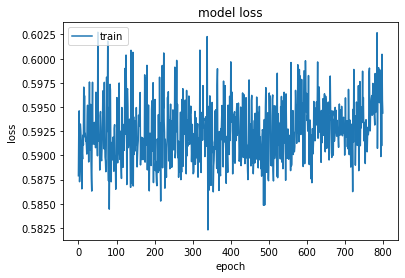

In [5]:
model = Sequential()

model.add(Dense(int(256), activation='relu'))
model.add(Dropout(.5))
model.add(Dense(64, activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(1))


#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam',  metrics=['mse'])

history = model.fit(X, np.array(y_train_log), validation_data=(X_test, np.array(y_val_log)),
                    batch_size=1024,epochs=1000)

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

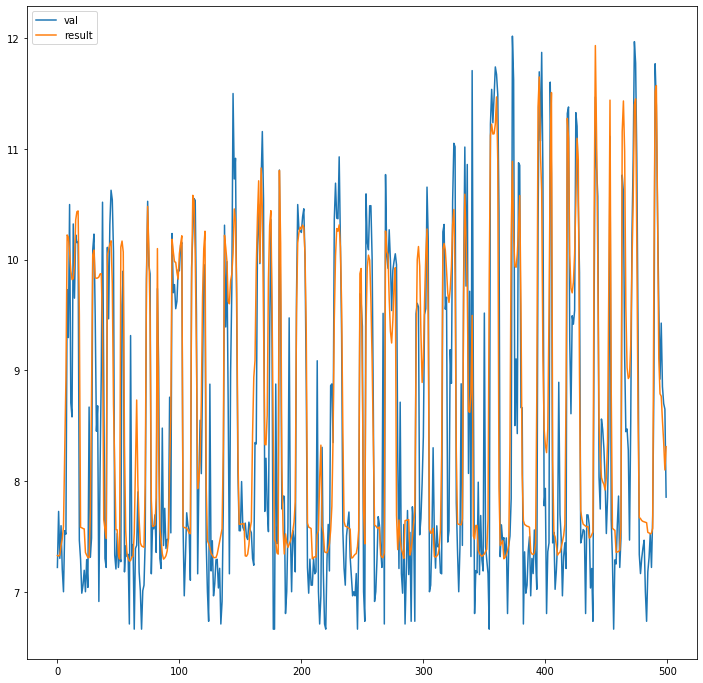

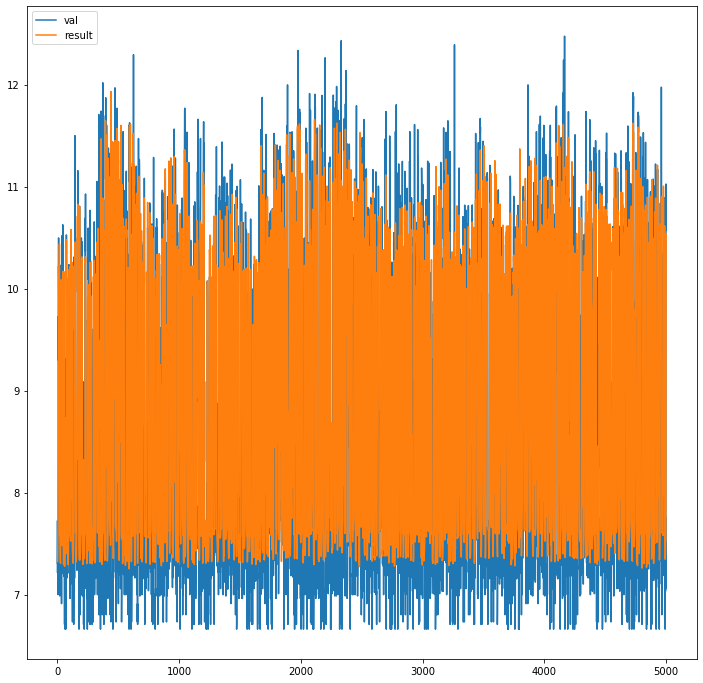

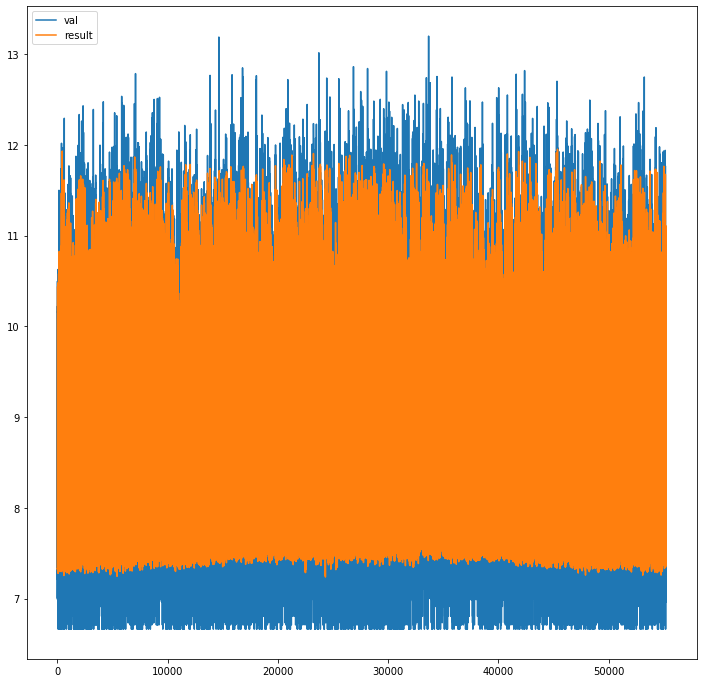

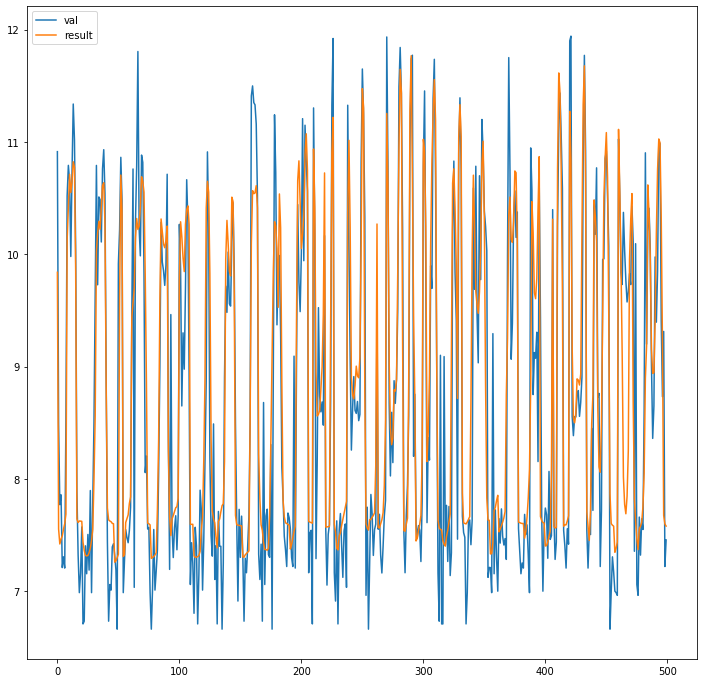

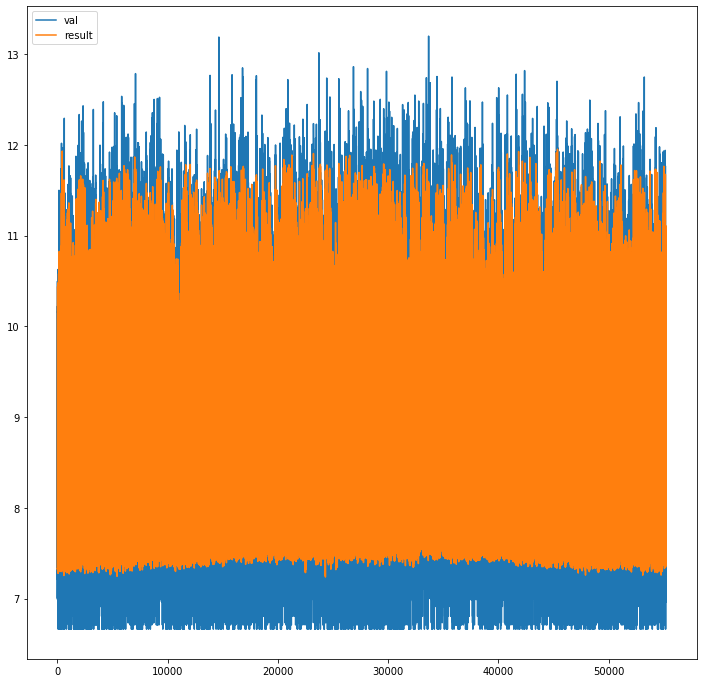

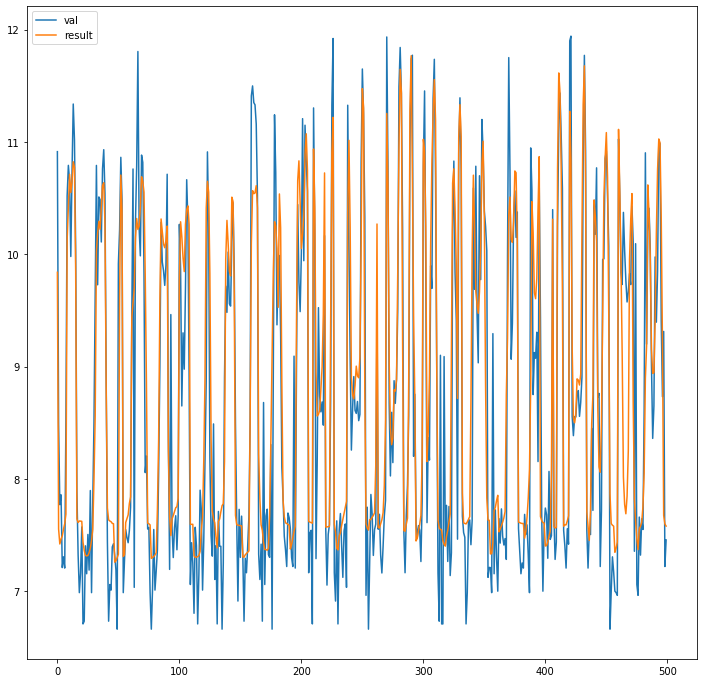

In [6]:
results = model.predict(X_val_scaled)#, y_val_log.values)#, batch_size=128)


plt.figure(figsize=(12,12))
plt.plot(y_val_log.values[:500])
plt.plot(results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure(figsize=(12,12))
plt.plot(y_val_log.values[:5000])
plt.plot(results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure(figsize=(12,12))
plt.plot(y_val_log.values[:])
plt.plot(results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure(figsize=(12,12))
plt.plot(y_val_log.values[-500:])
plt.plot(results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure(figsize=(12,12))
plt.plot(y_val_log.values[:])
plt.plot(results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure(figsize=(12,12))
plt.plot(y_val_log.values[-500:])
plt.plot(results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

# Read in the the auroral regions from a pickle file (constructed from auroral boundary transition points) 

In [25]:
# df_val.to_pickle('with_aurora_type_val.pkl')
# df_train.to_pickle('with_aurora_type_train.pkl')
df_val = pd.read_pickle("./with_aurora_type_val.pkl")
df_train = pd.read_pickle("./with_aurora_type_train.pkl")



In [26]:
sum(df_val['aurora_type']==5)/df_val['aurora_type'].shape[0]

0.564933888788263

In [27]:
sum(df_train['aurora_type']==5)/df_train['aurora_type'].shape[0]

0.5490338676186004

# The boundary transition type regions can be reduced to 3 instead of 4 regions (plus unknown region 5), because going into the auroal region from the equatorial region or the polar region is the same for our intention of labeling just equatorial region, auroral, region, or polar region. 

# therefore type 4 is the same as type 1

In [28]:
df_val['aurora_type'][ df_val['aurora_type']==4 ]= 1
df_train['aurora_type'][ df_train['aurora_type']==4 ]= 1


False
False
False


(array([ 7048.,     0., 10174.,     0.,     0.,  6626.,     0.,     0.,
            0., 31190.]),
 array([1. , 1.4, 1.8, 2.2, 2.6, 3. , 3.4, 3.8, 4.2, 4.6, 5. ]),
 <a list of 10 Patch objects>)

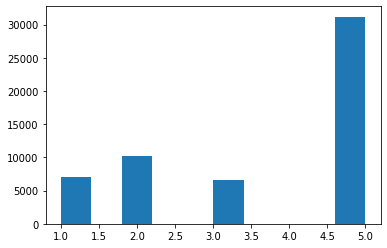

In [29]:

mask = ( np.isnan(df_train['aurora_type'])==False )
df_train_clean = df_train[mask].copy(deep=True)
print((mask.any())==False)
mask = ( np.isnan(df_val['aurora_type'])==False)
df_val_clean = df_val[mask].copy(deep=True)

print(np.isnan(df_val_clean).any().any())
print(np.isnan(df_train_clean).any().any())



plt.hist(df_val_clean['aurora_type'])

In [30]:

# Construct X and y
feature_cols = [c for c in df_train_clean.columns if not 'ELE' in c]
#print( (feature_cols))
#print(df_cumulative.columns)
from sklearn import preprocessing
X_val = df_val_clean[feature_cols].copy(deep=True)
y_val = df_val_clean['ELE_TOTAL_ENERGY_FLUX'].copy(deep=True)
X_train = df_train_clean[feature_cols].copy(deep=True)
y_train = df_train_clean['ELE_TOTAL_ENERGY_FLUX'].copy(deep=True)
scaler_X = preprocessing.RobustScaler()
scaler_X = scaler_X.fit(X_train.values)
X_val_scaled = scaler_X.transform(X_val.values)
X_train_scaled = scaler_X.transform(X_train.values)

numFeatures = len(X_train.columns.to_list())
feature_labels = X_train.columns.to_list()
y_train_erg = y_train.copy(deep=True) * (1.60218e-12)
y_val_erg = y_val.copy(deep=True) * (1.60218e-12)

y_train[y_train == 0] = 0.0001
y_val[y_val == 0] = 0.0001
y_train_log = np.log10(y_train.copy(deep=True))
y_val_log = np.log10(y_val.copy(deep=True))

%matplotlib inline  
import matplotlib.pyplot as plt
X = np.array(X_train_scaled, dtype=np.float32)
X_test = np.array(X_val_scaled, dtype=np.float32)

Y = np.array(y_train_log, dtype=np.float32)


In [31]:
X_train_no_aurora_type = X_train.drop(columns='aurora_type')
X_val_no_aurora_type = X_val.drop(columns='aurora_type')
scaler_X = scaler_X.fit(X_train_no_aurora_type.values)
X_val_no_aurora_type_scaled = scaler_X.transform(X_val_no_aurora_type.values)
X_train_no_aurora_type_scaled = scaler_X.transform(X_train_no_aurora_type.values)

y_train_aurora_type = X_train['aurora_type']
y_val_aurora_type = X_val['aurora_type']

In [32]:

label_encoder = LabelEncoder()
onehot_encoder = OneHotEncoder(sparse=False)

integer_encoded = label_encoder.fit_transform(y_train_aurora_type)
print(integer_encoded.shape)

integer_encoded_train = integer_encoded.reshape(len(integer_encoded), 1)
print(integer_encoded.shape)

y_train_aurora_type_encoded = onehot_encoder.fit_transform(integer_encoded_train)
integer_encoded = label_encoder.fit_transform(y_val_aurora_type)
integer_encoded_val = integer_encoded.reshape(len(integer_encoded), 1)
y_val_aurora_type_encoded = onehot_encoder.fit_transform(integer_encoded_val)

print(X_train_no_aurora_type_scaled.shape)

print(y_train_aurora_type.shape)
print(y_train_aurora_type_encoded.shape)

(720998,)
(720998,)
(720998, 148)
(720998,)
(720998, 4)


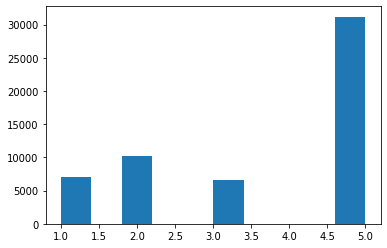

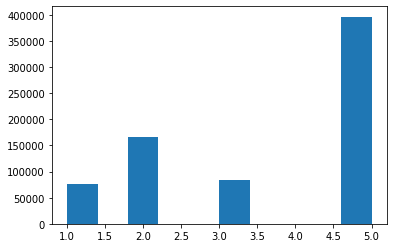

In [33]:
plt.hist(y_val_aurora_type)
plt.show()
plt.hist(y_train_aurora_type)
plt.show()

False
(324651,)
(324651,)
(324651, 148)
(324651,)
(324651, 3)


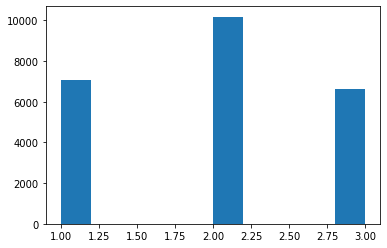

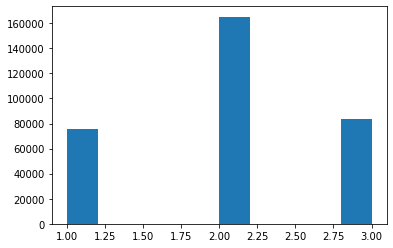

In [34]:

mask = [ (np.isnan(df_train['aurora_type'])==False) & (df_train['aurora_type'] != 5 ) ]
df_train_clean = df_train[mask[0]].copy(deep=True)
print((mask[0].any())==False)
mask = [ (np.isnan(df_val['aurora_type'])==False) & (df_val['aurora_type'] != 5 ) ]
df_val_clean = df_val[mask[0]].copy(deep=True)



# Construct X and y
feature_cols = [c for c in df_train_clean.columns if not 'ELE' in c]
from sklearn import preprocessing
X_val = df_val_clean[feature_cols].copy(deep=True)
y_val = df_val_clean['ELE_TOTAL_ENERGY_FLUX'].copy(deep=True)
X_train = df_train_clean[feature_cols].copy(deep=True)
y_train = df_train_clean['ELE_TOTAL_ENERGY_FLUX'].copy(deep=True)
scaler_X = preprocessing.RobustScaler()
scaler_X = scaler_X.fit(X_train.values)
X_val_scaled = scaler_X.transform(X_val.values)
X_train_scaled = scaler_X.transform(X_train.values)

numFeatures = len(X_train.columns.to_list())
feature_labels = X_train.columns.to_list()
y_train_erg = y_train.copy(deep=True) * (1.60218e-12)
y_val_erg = y_val.copy(deep=True) * (1.60218e-12)

y_train[y_train == 0] = 0.0001
y_val[y_val == 0] = 0.0001
y_train_log = np.log10(y_train.copy(deep=True))
y_val_log = np.log10(y_val.copy(deep=True))


X = np.array(X_train_scaled, dtype=np.float32)
X_test = np.array(X_val_scaled, dtype=np.float32)

Y = np.array(y_train_log, dtype=np.float32)

X_train_no_aurora_type = X_train.drop(columns='aurora_type')
X_val_no_aurora_type = X_val.drop(columns='aurora_type')
scaler_X = scaler_X.fit(X_train_no_aurora_type.values)
X_val_no_aurora_type_scaled = scaler_X.transform(X_val_no_aurora_type.values)
X_train_no_aurora_type_scaled = scaler_X.transform(X_train_no_aurora_type.values)

y_train_aurora_type = X_train['aurora_type']
y_val_aurora_type = X_val['aurora_type']

label_encoder = LabelEncoder()
onehot_encoder = OneHotEncoder(sparse=False)

integer_encoded = label_encoder.fit_transform(y_train_aurora_type)
print(integer_encoded.shape)

integer_encoded_train = integer_encoded.reshape(len(integer_encoded), 1)
print(integer_encoded.shape)

y_train_aurora_type_encoded = onehot_encoder.fit_transform(integer_encoded_train)
integer_encoded = label_encoder.fit_transform(y_val_aurora_type)
integer_encoded_val = integer_encoded.reshape(len(integer_encoded), 1)
y_val_aurora_type_encoded = onehot_encoder.fit_transform(integer_encoded_val)

print(X_train_no_aurora_type_scaled.shape)

print(y_train_aurora_type.shape)
print(y_train_aurora_type_encoded.shape)

sum(df_val_clean['aurora_type']==2)/df_val_clean.shape[0]
sum(df_train_clean['aurora_type']==2)/df_train_clean.shape[0]



plt.hist(y_val_aurora_type)
plt.show()
plt.hist(y_train_aurora_type)
plt.show()

In [35]:
model = Sequential()

# model.add(Dense(int(256), activation='relu'))
# model.add(Dense(64, activation='relu'))
# model.add(Dense(8, activation='relu'))
# model.add(Dense(4,activation='softmax'))
model.add(Dense(int(256), activation='relu'))
model.add(Dropout(.5))

model.add(Dense(64, activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(3,activation='softmax'))

#compile model using accuracy to measure model performance
model.compile(loss=tf.keras.losses.CategoricalCrossentropy(from_logits=False), optimizer='adam',  metrics=['accuracy'])

history = model.fit(X_train_no_aurora_type_scaled, y_train_aurora_type_encoded, validation_data=(X_val_no_aurora_type_scaled, y_val_aurora_type_encoded), batch_size=32,epochs=1000)

Epoch 1/1000
10146/10146 [==============================] - 34s 3ms/step - loss: 0.3144 - accuracy: 0.8688 - val_loss: 0.2531 - val_accuracy: 0.8912
Epoch 2/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.2373 - accuracy: 0.9001 - val_loss: 0.2220 - val_accuracy: 0.9046
Epoch 3/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.2244 - accuracy: 0.9060 - val_loss: 0.2062 - val_accuracy: 0.9147
Epoch 4/1000
10146/10146 [==============================] - 37s 4ms/step - loss: 0.2169 - accuracy: 0.9089 - val_loss: 0.1991 - val_accuracy: 0.9130
Epoch 5/1000
10146/10146 [==============================] - 40s 4ms/step - loss: 0.2122 - accuracy: 0.9115 - val_loss: 0.2007 - val_accuracy: 0.9162
Epoch 6/1000
10146/10146 [==============================] - 40s 4ms/step - loss: 0.2080 - accuracy: 0.9126 - val_loss: 0.2069 - val_accuracy: 0.9114
Epoch 7/1000
10146/10146 [==============================] - 39s 4ms/step - loss: 0.2063 - accuracy: 0.9138

10146/10146 [==============================] - 34s 3ms/step - loss: 0.1778 - accuracy: 0.9256 - val_loss: 0.1908 - val_accuracy: 0.9190
Epoch 56/1000
10146/10146 [==============================] - 34s 3ms/step - loss: 0.1794 - accuracy: 0.9261 - val_loss: 0.1896 - val_accuracy: 0.9188
Epoch 57/1000
10146/10146 [==============================] - 34s 3ms/step - loss: 0.1775 - accuracy: 0.9257 - val_loss: 0.1885 - val_accuracy: 0.9179
Epoch 58/1000
10146/10146 [==============================] - 34s 3ms/step - loss: 0.1781 - accuracy: 0.9253 - val_loss: 0.1929 - val_accuracy: 0.9169
Epoch 59/1000
10146/10146 [==============================] - 34s 3ms/step - loss: 0.1767 - accuracy: 0.9259 - val_loss: 0.1884 - val_accuracy: 0.9197
Epoch 60/1000
10146/10146 [==============================] - 34s 3ms/step - loss: 0.1776 - accuracy: 0.9261 - val_loss: 0.1907 - val_accuracy: 0.9185
Epoch 61/1000
10146/10146 [==============================] - 34s 3ms/step - loss: 0.1764 - accuracy: 0.9259 - val_

10146/10146 [==============================] - 33s 3ms/step - loss: 0.1922 - accuracy: 0.9280 - val_loss: 0.1932 - val_accuracy: 0.9153
Epoch 110/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1709 - accuracy: 0.9287 - val_loss: 0.1934 - val_accuracy: 0.9168
Epoch 111/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1714 - accuracy: 0.9286 - val_loss: 0.1950 - val_accuracy: 0.9160
Epoch 112/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1710 - accuracy: 0.9285 - val_loss: 0.1937 - val_accuracy: 0.9175
Epoch 113/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1697 - accuracy: 0.9292 - val_loss: 0.1910 - val_accuracy: 0.9176
Epoch 114/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1718 - accuracy: 0.9287 - val_loss: 0.1956 - val_accuracy: 0.9148
Epoch 115/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1714 - accuracy: 0.9288 

10146/10146 [==============================] - 33s 3ms/step - loss: 0.1665 - accuracy: 0.9304 - val_loss: 0.1960 - val_accuracy: 0.9169
Epoch 164/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1670 - accuracy: 0.9305 - val_loss: 0.1903 - val_accuracy: 0.9186
Epoch 165/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1672 - accuracy: 0.9305 - val_loss: 0.1957 - val_accuracy: 0.9155
Epoch 166/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1670 - accuracy: 0.9304 - val_loss: 0.1893 - val_accuracy: 0.9183
Epoch 167/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1692 - accuracy: 0.9305 - val_loss: 0.1968 - val_accuracy: 0.9151
Epoch 168/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1661 - accuracy: 0.9306 - val_loss: 0.1945 - val_accuracy: 0.9159
Epoch 169/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1664 - accuracy: 0.9305 

10146/10146 [==============================] - 33s 3ms/step - loss: 0.1634 - accuracy: 0.9320 - val_loss: 0.1919 - val_accuracy: 0.9165
Epoch 218/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1647 - accuracy: 0.9319 - val_loss: 0.1933 - val_accuracy: 0.9158
Epoch 219/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1657 - accuracy: 0.9316 - val_loss: 0.1970 - val_accuracy: 0.9168
Epoch 220/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1658 - accuracy: 0.9319 - val_loss: 0.2025 - val_accuracy: 0.9142
Epoch 221/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1643 - accuracy: 0.9321 - val_loss: 0.1956 - val_accuracy: 0.9155
Epoch 222/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1639 - accuracy: 0.9322 - val_loss: 0.1897 - val_accuracy: 0.9183
Epoch 223/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1635 - accuracy: 0.9323 

10146/10146 [==============================] - 33s 3ms/step - loss: 0.1619 - accuracy: 0.9328 - val_loss: 0.1916 - val_accuracy: 0.9161
Epoch 272/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1618 - accuracy: 0.9334 - val_loss: 0.1945 - val_accuracy: 0.9184
Epoch 273/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1612 - accuracy: 0.9331 - val_loss: 0.2058 - val_accuracy: 0.9154
Epoch 274/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1637 - accuracy: 0.9327 - val_loss: 0.2001 - val_accuracy: 0.9170
Epoch 275/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1605 - accuracy: 0.9328 - val_loss: 0.1991 - val_accuracy: 0.9145
Epoch 276/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1621 - accuracy: 0.9330 - val_loss: 0.1950 - val_accuracy: 0.9172
Epoch 277/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1621 - accuracy: 0.9326 

10146/10146 [==============================] - 33s 3ms/step - loss: 0.1589 - accuracy: 0.9336 - val_loss: 0.2034 - val_accuracy: 0.9121
Epoch 326/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1620 - accuracy: 0.9334 - val_loss: 0.1999 - val_accuracy: 0.9157
Epoch 327/1000
10146/10146 [==============================] - 32s 3ms/step - loss: 0.1609 - accuracy: 0.9335 - val_loss: 0.2014 - val_accuracy: 0.9158
Epoch 328/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1628 - accuracy: 0.9335 - val_loss: 0.1940 - val_accuracy: 0.9155
Epoch 329/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1596 - accuracy: 0.9338 - val_loss: 0.2022 - val_accuracy: 0.9168
Epoch 330/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1597 - accuracy: 0.9341 - val_loss: 0.1981 - val_accuracy: 0.9142
Epoch 331/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1596 - accuracy: 0.9338 

10146/10146 [==============================] - 32s 3ms/step - loss: 0.1575 - accuracy: 0.9347 - val_loss: 0.1971 - val_accuracy: 0.9151
Epoch 380/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1593 - accuracy: 0.9342 - val_loss: 0.1998 - val_accuracy: 0.9151
Epoch 381/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1587 - accuracy: 0.9348 - val_loss: 0.1952 - val_accuracy: 0.9160
Epoch 382/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1591 - accuracy: 0.9344 - val_loss: 0.1991 - val_accuracy: 0.9161
Epoch 383/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1651 - accuracy: 0.9342 - val_loss: 0.1997 - val_accuracy: 0.9161
Epoch 384/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1580 - accuracy: 0.9342 - val_loss: 0.1981 - val_accuracy: 0.9153
Epoch 385/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1593 - accuracy: 0.9347 

10146/10146 [==============================] - 33s 3ms/step - loss: 0.1571 - accuracy: 0.9351 - val_loss: 0.1960 - val_accuracy: 0.9163
Epoch 434/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1576 - accuracy: 0.9351 - val_loss: 0.1957 - val_accuracy: 0.9168
Epoch 435/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1603 - accuracy: 0.9348 - val_loss: 0.2020 - val_accuracy: 0.9168
Epoch 436/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1615 - accuracy: 0.9347 - val_loss: 0.1987 - val_accuracy: 0.9155
Epoch 437/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1570 - accuracy: 0.9350 - val_loss: 0.2016 - val_accuracy: 0.9162
Epoch 438/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1594 - accuracy: 0.9355 - val_loss: 0.2119 - val_accuracy: 0.9142
Epoch 439/1000
10146/10146 [==============================] - 32s 3ms/step - loss: 0.1677 - accuracy: 0.9351 

10146/10146 [==============================] - 33s 3ms/step - loss: 0.1605 - accuracy: 0.9352 - val_loss: 0.2052 - val_accuracy: 0.9142
Epoch 488/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1653 - accuracy: 0.9355 - val_loss: 0.1998 - val_accuracy: 0.9148
Epoch 489/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1566 - accuracy: 0.9352 - val_loss: 0.2031 - val_accuracy: 0.9148
Epoch 490/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1577 - accuracy: 0.9357 - val_loss: 0.2060 - val_accuracy: 0.9151
Epoch 491/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1571 - accuracy: 0.9354 - val_loss: 0.1995 - val_accuracy: 0.9145
Epoch 492/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1605 - accuracy: 0.9361 - val_loss: 0.1992 - val_accuracy: 0.9169
Epoch 493/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1570 - accuracy: 0.9353 

10146/10146 [==============================] - 33s 3ms/step - loss: 0.1648 - accuracy: 0.9356 - val_loss: 0.2118 - val_accuracy: 0.9153
Epoch 542/1000
10146/10146 [==============================] - 32s 3ms/step - loss: 0.1596 - accuracy: 0.9362 - val_loss: 0.2093 - val_accuracy: 0.9145
Epoch 543/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1569 - accuracy: 0.9359 - val_loss: 0.2054 - val_accuracy: 0.9150
Epoch 544/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1563 - accuracy: 0.9359 - val_loss: 0.1961 - val_accuracy: 0.9144
Epoch 545/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1574 - accuracy: 0.9359 - val_loss: 0.2011 - val_accuracy: 0.9164
Epoch 546/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1540 - accuracy: 0.9363 - val_loss: 0.1920 - val_accuracy: 0.9174
Epoch 547/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1582 - accuracy: 0.9362 

10146/10146 [==============================] - 33s 3ms/step - loss: 0.1564 - accuracy: 0.9358 - val_loss: 0.2009 - val_accuracy: 0.9151
Epoch 596/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1545 - accuracy: 0.9364 - val_loss: 0.2007 - val_accuracy: 0.9135
Epoch 597/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1550 - accuracy: 0.9364 - val_loss: 0.2074 - val_accuracy: 0.9142
Epoch 598/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1550 - accuracy: 0.9359 - val_loss: 0.1999 - val_accuracy: 0.9155
Epoch 599/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1553 - accuracy: 0.9364 - val_loss: 0.2052 - val_accuracy: 0.9118
Epoch 600/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1587 - accuracy: 0.9367 - val_loss: 0.1993 - val_accuracy: 0.9158
Epoch 601/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1544 - accuracy: 0.9360 

10146/10146 [==============================] - 33s 3ms/step - loss: 0.1543 - accuracy: 0.9364 - val_loss: 0.2097 - val_accuracy: 0.9127
Epoch 650/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1556 - accuracy: 0.9360 - val_loss: 0.2113 - val_accuracy: 0.9161
Epoch 651/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1565 - accuracy: 0.9357 - val_loss: 0.2053 - val_accuracy: 0.9131
Epoch 652/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1576 - accuracy: 0.9368 - val_loss: 0.2032 - val_accuracy: 0.9145
Epoch 653/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1549 - accuracy: 0.9369 - val_loss: 0.2043 - val_accuracy: 0.9138
Epoch 654/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1547 - accuracy: 0.9367 - val_loss: 0.1967 - val_accuracy: 0.9146
Epoch 655/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1555 - accuracy: 0.9366 

10146/10146 [==============================] - 33s 3ms/step - loss: 0.1555 - accuracy: 0.9367 - val_loss: 0.2028 - val_accuracy: 0.9130
Epoch 704/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1531 - accuracy: 0.9371 - val_loss: 0.2137 - val_accuracy: 0.9153
Epoch 705/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1574 - accuracy: 0.9362 - val_loss: 0.2106 - val_accuracy: 0.9153
Epoch 706/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1548 - accuracy: 0.9370 - val_loss: 0.2066 - val_accuracy: 0.9142
Epoch 707/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1560 - accuracy: 0.9368 - val_loss: 0.2015 - val_accuracy: 0.9127
Epoch 708/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1535 - accuracy: 0.9369 - val_loss: 0.2079 - val_accuracy: 0.9150
Epoch 709/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1534 - accuracy: 0.9372 

10146/10146 [==============================] - 33s 3ms/step - loss: 0.1537 - accuracy: 0.9374 - val_loss: 0.2095 - val_accuracy: 0.9145
Epoch 758/1000
10146/10146 [==============================] - 32s 3ms/step - loss: 0.1540 - accuracy: 0.9377 - val_loss: 0.2048 - val_accuracy: 0.9142
Epoch 759/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1604 - accuracy: 0.9369 - val_loss: 0.2005 - val_accuracy: 0.9135
Epoch 760/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1530 - accuracy: 0.9373 - val_loss: 0.2031 - val_accuracy: 0.9156
Epoch 761/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1554 - accuracy: 0.9372 - val_loss: 0.2074 - val_accuracy: 0.9139
Epoch 762/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1528 - accuracy: 0.9377 - val_loss: 0.2103 - val_accuracy: 0.9132
Epoch 763/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1554 - accuracy: 0.9374 

10146/10146 [==============================] - 33s 3ms/step - loss: 0.1532 - accuracy: 0.9371 - val_loss: 0.2062 - val_accuracy: 0.9153
Epoch 812/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1546 - accuracy: 0.9374 - val_loss: 0.2065 - val_accuracy: 0.9156
Epoch 813/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1529 - accuracy: 0.9373 - val_loss: 0.2045 - val_accuracy: 0.9145
Epoch 814/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1507 - accuracy: 0.9378 - val_loss: 0.2091 - val_accuracy: 0.9143
Epoch 815/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1536 - accuracy: 0.9373 - val_loss: 0.2133 - val_accuracy: 0.9142
Epoch 816/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1531 - accuracy: 0.9378 - val_loss: 0.2011 - val_accuracy: 0.9135
Epoch 817/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1540 - accuracy: 0.9376 

10146/10146 [==============================] - 32s 3ms/step - loss: 0.1538 - accuracy: 0.9379 - val_loss: 0.2106 - val_accuracy: 0.9162
Epoch 866/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1541 - accuracy: 0.9382 - val_loss: 0.2102 - val_accuracy: 0.9152
Epoch 867/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1521 - accuracy: 0.9380 - val_loss: 0.2049 - val_accuracy: 0.9105
Epoch 868/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1585 - accuracy: 0.9383 - val_loss: 0.2040 - val_accuracy: 0.9145
Epoch 869/1000
10146/10146 [==============================] - 32s 3ms/step - loss: 0.1518 - accuracy: 0.9375 - val_loss: 0.2067 - val_accuracy: 0.9111
Epoch 870/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1515 - accuracy: 0.9376 - val_loss: 0.2101 - val_accuracy: 0.9158
Epoch 871/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1516 - accuracy: 0.9380 

10146/10146 [==============================] - 33s 3ms/step - loss: 0.1543 - accuracy: 0.9377 - val_loss: 0.2094 - val_accuracy: 0.9149
Epoch 920/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1535 - accuracy: 0.9380 - val_loss: 0.2063 - val_accuracy: 0.9157
Epoch 921/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1558 - accuracy: 0.9381 - val_loss: 0.2035 - val_accuracy: 0.9158
Epoch 922/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1515 - accuracy: 0.9377 - val_loss: 0.2087 - val_accuracy: 0.9150
Epoch 923/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1549 - accuracy: 0.9381 - val_loss: 0.2047 - val_accuracy: 0.9168
Epoch 924/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1512 - accuracy: 0.9381 - val_loss: 0.2113 - val_accuracy: 0.9162
Epoch 925/1000
10146/10146 [==============================] - 33s 3ms/step - loss: 0.1508 - accuracy: 0.9378 

10146/10146 [==============================] - 16s 2ms/step - loss: 0.1517 - accuracy: 0.9379 - val_loss: 0.2182 - val_accuracy: 0.9135
Epoch 974/1000
10146/10146 [==============================] - 17s 2ms/step - loss: 0.1527 - accuracy: 0.9386 - val_loss: 0.2143 - val_accuracy: 0.9150
Epoch 975/1000
10146/10146 [==============================] - 16s 2ms/step - loss: 0.1554 - accuracy: 0.9381 - val_loss: 0.2035 - val_accuracy: 0.9144
Epoch 976/1000
10146/10146 [==============================] - 17s 2ms/step - loss: 0.1506 - accuracy: 0.9382 - val_loss: 0.2122 - val_accuracy: 0.9163
Epoch 977/1000
10146/10146 [==============================] - 17s 2ms/step - loss: 0.1513 - accuracy: 0.9383 - val_loss: 0.2074 - val_accuracy: 0.9135
Epoch 978/1000
10146/10146 [==============================] - 17s 2ms/step - loss: 0.1575 - accuracy: 0.9378 - val_loss: 0.2179 - val_accuracy: 0.9131
Epoch 979/1000
10146/10146 [==============================] - 16s 2ms/step - loss: 0.1496 - accuracy: 0.9383 

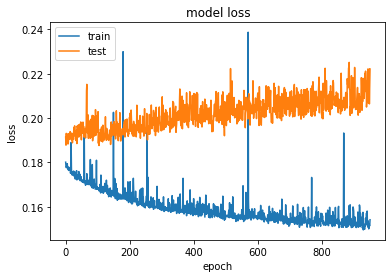

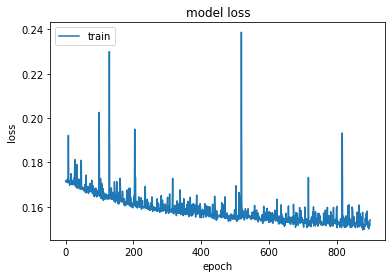

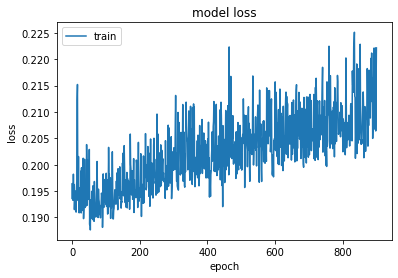

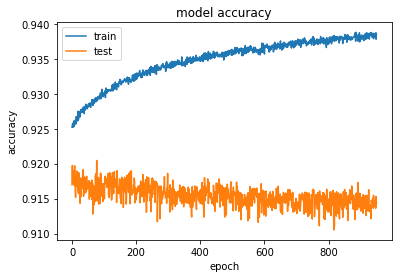

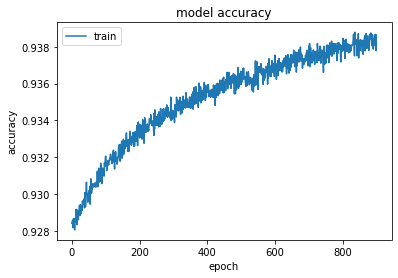

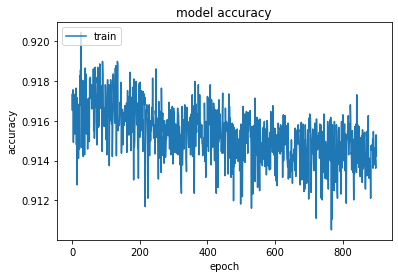

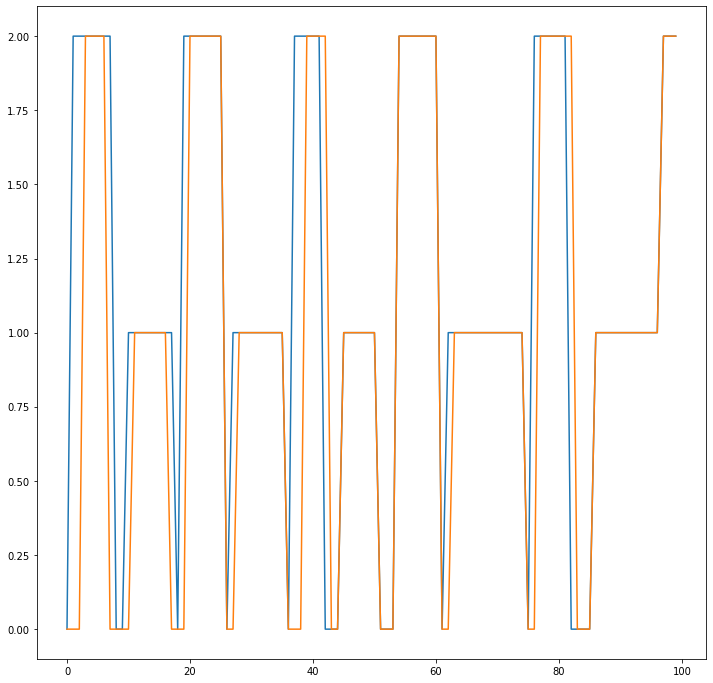

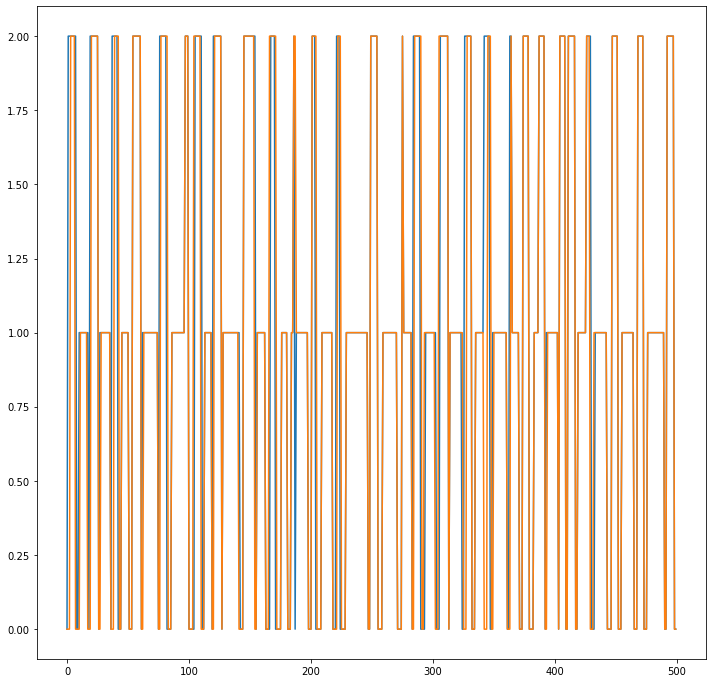

In [36]:
plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][50:])
plt.plot(history.history['val_loss'][50:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][100:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][100:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['accuracy'][50:])
plt.plot(history.history['val_accuracy'][50:])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['accuracy'][100:])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_accuracy'][100:])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()


results = (model.predict_classes(X_val_no_aurora_type_scaled))#, y_val_log.values)#, batch_size=128)



# plt.figure(figsize=(12,12))

# plt.plot( integer_encoded_val[:3000])
# plt.plot(results[:3000])
# plt.show()
plt.figure(figsize=(12,12))

plt.plot( integer_encoded_val[:100])
plt.plot(results[:100])
plt.show()

plt.figure(figsize=(12,12))

plt.plot( integer_encoded_val[:500])
plt.plot(results[:500])
plt.show()

In [48]:
model = Sequential()

model.add(Dense(int(256), activation='relu'))
model.add(Dropout(.5))

model.add(Dense(64, activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(3,activation='softmax'))

#compile model using accuracy to measure model performance
model.compile(loss=tf.keras.losses.CategoricalCrossentropy(from_logits=False), optimizer='adam',  metrics=['accuracy'])

history = model.fit(X_train_no_aurora_type_scaled, y_train_aurora_type_encoded, validation_data=(X_val_no_aurora_type_scaled, y_val_aurora_type_encoded), batch_size=32,epochs=75)

Epoch 1/75
10146/10146 [==============================] - 17s 2ms/step - loss: 0.3149 - accuracy: 0.8679 - val_loss: 0.2340 - val_accuracy: 0.9021
Epoch 2/75
10146/10146 [==============================] - 17s 2ms/step - loss: 0.2365 - accuracy: 0.9008 - val_loss: 0.2162 - val_accuracy: 0.9126
Epoch 3/75
10146/10146 [==============================] - 26s 3ms/step - loss: 0.2237 - accuracy: 0.9060 - val_loss: 0.2140 - val_accuracy: 0.9120
Epoch 4/75
10146/10146 [==============================] - 33s 3ms/step - loss: 0.2188 - accuracy: 0.9085 - val_loss: 0.2009 - val_accuracy: 0.9145
Epoch 5/75
10146/10146 [==============================] - 34s 3ms/step - loss: 0.2119 - accuracy: 0.9110 - val_loss: 0.1989 - val_accuracy: 0.9155
Epoch 6/75
10146/10146 [==============================] - 33s 3ms/step - loss: 0.2085 - accuracy: 0.9127 - val_loss: 0.1994 - val_accuracy: 0.9159
Epoch 7/75
10146/10146 [==============================] - 32s 3ms/step - loss: 0.2060 - accuracy: 0.9139 - val_loss: 0

10146/10146 [==============================] - 33s 3ms/step - loss: 0.1784 - accuracy: 0.9255 - val_loss: 0.1921 - val_accuracy: 0.9187
Epoch 57/75
10146/10146 [==============================] - 22s 2ms/step - loss: 0.1777 - accuracy: 0.9257 - val_loss: 0.1914 - val_accuracy: 0.9190
Epoch 58/75
10146/10146 [==============================] - 21s 2ms/step - loss: 0.1780 - accuracy: 0.9256 - val_loss: 0.1968 - val_accuracy: 0.9178
Epoch 59/75
10146/10146 [==============================] - 21s 2ms/step - loss: 0.1788 - accuracy: 0.9257 - val_loss: 0.1875 - val_accuracy: 0.9196
Epoch 60/75
10146/10146 [==============================] - 21s 2ms/step - loss: 0.1772 - accuracy: 0.9256 - val_loss: 0.1920 - val_accuracy: 0.9170
Epoch 61/75
10146/10146 [==============================] - 20s 2ms/step - loss: 0.1777 - accuracy: 0.9258 - val_loss: 0.1910 - val_accuracy: 0.9182
Epoch 62/75
10146/10146 [==============================] - 21s 2ms/step - loss: 0.1765 - accuracy: 0.9258 - val_loss: 0.1932

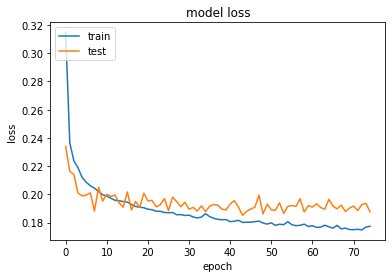

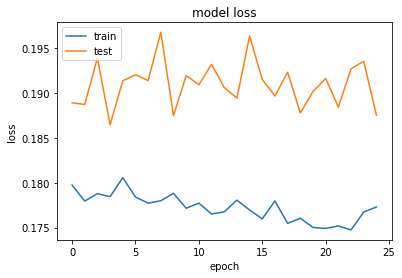

In [49]:
plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][:])
plt.plot(history.history['val_loss'][:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][50:])
plt.plot(history.history['val_loss'][50:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

# Now use this Auroal region predictor model to predict what type the "unknown/unspecified" regions are.  Then combine this predicted data with the known training and test data

In [50]:
 
mask = [ (np.isnan(df_train['aurora_type'])==True) | (df_train['aurora_type'] == 5 ) ]
df_train_pred = df_train[mask[0]].copy(deep=True)
print((mask[0].any())==False)
mask = [ (np.isnan(df_val['aurora_type'])==True) | (df_val['aurora_type'] == 5 ) ]
df_val_pred = df_val[mask[0]].copy(deep=True)
print(df_train_pred.shape)
print(df_val_pred.shape)

False
(397248, 150)
(31362, 150)


In [52]:
print(df_train_pred.columns)

# Construct X and y
feature_cols = [c for c in df_train_pred.columns if (not ( 'ELE' in c) | ('aurora_type' in c))]
X_train = df_train_pred[feature_cols].copy(deep=True)
X_val = df_val_pred[feature_cols].copy(deep=True)
print(X_train.shape)
scaler_X = preprocessing.RobustScaler()
scaler_X = scaler_X.fit(X_train.values)
X_val_scaled = scaler_X.transform(X_val.values)
X_train_scaled = scaler_X.transform(X_train.values)
X = np.array(X_train_scaled, dtype=np.float32)
X_test = np.array(X_val_scaled, dtype=np.float32)
#scaler_X = scaler_X.fit(X_train_no_aurora_type.values)



Index(['SC_AACGM_LAT', 'ELE_TOTAL_ENERGY_FLUX', 'ID_SC', 'sin_ut', 'cos_ut',
       'sin_doy', 'cos_doy', 'sin_SC_AACGM_LTIME', 'cos_SC_AACGM_LTIME',
       'F107',
       ...
       'AL_5min', 'AU_5min', 'SymH_5min', 'PC_5min', 'vsw_5min', 'vx_5min',
       'psw_5min', 'borovsky_5min', 'newell_5min', 'aurora_type'],
      dtype='object', length=150)
(397248, 148)


In [53]:

print(X.shape)

print((model.predict_classes(X_train_no_aurora_type_scaled)).shape)
print(df_train_pred.shape)

df_train_pred['aurora_type']= model.predict_classes(X)
df_val_pred['aurora_type']= model.predict_classes(X_test)

print(df_train_pred.shape)
print(df_train_clean.shape)

frames = [df_train_clean, df_train_pred]
df_train_new = pd.concat(frames)
frames = [df_val_clean, df_val_pred]
df_val_new = pd.concat(frames) 

(397248, 148)
(324651,)
(397248, 150)
(397248, 150)
(324651, 150)


In [54]:

# Construct X and y
feature_cols = [c for c in df_train_new.columns if not 'ELE' in c]
#print( (feature_cols))
#print(df_cumulative.columns)
from sklearn import preprocessing
X_val = df_val_new[feature_cols].copy(deep=True)
y_val = df_val_new['ELE_TOTAL_ENERGY_FLUX'].copy(deep=True)
X_train = df_train_new[feature_cols].copy(deep=True)
y_train = df_train_new['ELE_TOTAL_ENERGY_FLUX'].copy(deep=True)
scaler_X = preprocessing.RobustScaler()
scaler_X = scaler_X.fit(X_train.values)
X_val_scaled = scaler_X.transform(X_val.values)
X_train_scaled = scaler_X.transform(X_train.values)

numFeatures = len(X_train.columns.to_list())
feature_labels = X_train.columns.to_list()
y_train_erg = y_train.copy(deep=True) * (1.60218e-12)
y_val_erg = y_val.copy(deep=True) * (1.60218e-12)

y_train[y_train == 0] = 0.0001
y_val[y_val == 0] = 0.0001
y_train_log = np.log10(y_train.copy(deep=True))
y_val_log = np.log10(y_val.copy(deep=True))

%matplotlib inline  
import matplotlib.pyplot as plt
X = np.array(X_train_scaled, dtype=np.float32)
X_test = np.array(X_val_scaled, dtype=np.float32)


# Now with the supervised auroral type values and the predicted (unsupervised) type values as a new column in the input X, predict the scalar energy flux y

In [55]:
model = Sequential()

model.add(Dense(int(256), activation='relu'))
model.add(Dropout(.5))
model.add(Dense(64, activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(1))


#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam',  metrics=['mse'])

history = model.fit(X, np.array(y_train_log), validation_data=(X_test, np.array(y_val_log)), batch_size=1024,epochs=1000)

Epoch 1/1000
705/705 [==============================] - 2s 2ms/step - loss: 10.4506 - mse: 10.4506 - val_loss: 1.9489 - val_mse: 1.9489
Epoch 2/1000
705/705 [==============================] - 2s 2ms/step - loss: 2.2134 - mse: 2.2134 - val_loss: 1.4585 - val_mse: 1.4585
Epoch 3/1000
705/705 [==============================] - 2s 2ms/step - loss: 1.3514 - mse: 1.3514 - val_loss: 1.2587 - val_mse: 1.2587
Epoch 4/1000
705/705 [==============================] - 2s 2ms/step - loss: 1.0131 - mse: 1.0131 - val_loss: 1.0589 - val_mse: 1.0589
Epoch 5/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.9117 - mse: 0.9117 - val_loss: 0.9785 - val_mse: 0.9785
Epoch 6/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.8513 - mse: 0.8513 - val_loss: 0.8956 - val_mse: 0.8956
Epoch 7/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.7870 - mse: 0.7870 - val_loss: 0.8731 - val_mse: 0.8731
Epoch 8/1000
705/705 [==============================] - 2s 2

Epoch 62/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4572 - mse: 0.4572 - val_loss: 0.5754 - val_mse: 0.5754
Epoch 63/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4601 - mse: 0.4601 - val_loss: 0.5710 - val_mse: 0.5710
Epoch 64/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4566 - mse: 0.4566 - val_loss: 0.5718 - val_mse: 0.5718
Epoch 65/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4549 - mse: 0.4549 - val_loss: 0.5816 - val_mse: 0.5816
Epoch 66/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4557 - mse: 0.4557 - val_loss: 0.5762 - val_mse: 0.5762
Epoch 67/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4555 - mse: 0.4555 - val_loss: 0.5765 - val_mse: 0.5765
Epoch 68/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4531 - mse: 0.4531 - val_loss: 0.5722 - val_mse: 0.5722
Epoch 69/1000
705/705 [==============================] 

705/705 [==============================] - 2s 2ms/step - loss: 0.4373 - mse: 0.4373 - val_loss: 0.5701 - val_mse: 0.5701
Epoch 123/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4364 - mse: 0.4364 - val_loss: 0.5691 - val_mse: 0.5691
Epoch 124/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4371 - mse: 0.4371 - val_loss: 0.5710 - val_mse: 0.5710
Epoch 125/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4363 - mse: 0.4363 - val_loss: 0.5702 - val_mse: 0.5702
Epoch 126/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4366 - mse: 0.4366 - val_loss: 0.5642 - val_mse: 0.5642
Epoch 127/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4362 - mse: 0.4362 - val_loss: 0.5664 - val_mse: 0.5664
Epoch 128/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.4359 - mse: 0.4359 - val_loss: 0.5741 - val_mse: 0.5741
Epoch 129/1000
705/705 [==============================] - 2s 2m

705/705 [==============================] - 2s 2ms/step - loss: 0.4279 - mse: 0.4279 - val_loss: 0.5689 - val_mse: 0.5689
Epoch 183/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4296 - mse: 0.4296 - val_loss: 0.5696 - val_mse: 0.5696
Epoch 184/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4276 - mse: 0.4276 - val_loss: 0.5586 - val_mse: 0.5586
Epoch 185/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.4284 - mse: 0.4284 - val_loss: 0.5672 - val_mse: 0.5672
Epoch 186/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4277 - mse: 0.4277 - val_loss: 0.5623 - val_mse: 0.5623
Epoch 187/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4274 - mse: 0.4274 - val_loss: 0.5630 - val_mse: 0.5630
Epoch 188/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4275 - mse: 0.4275 - val_loss: 0.5607 - val_mse: 0.5607
Epoch 189/1000
705/705 [==============================] - 2s 2m

705/705 [==============================] - 2s 2ms/step - loss: 0.4222 - mse: 0.4222 - val_loss: 0.5685 - val_mse: 0.5685
Epoch 243/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4228 - mse: 0.4228 - val_loss: 0.5642 - val_mse: 0.5642
Epoch 244/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4230 - mse: 0.4230 - val_loss: 0.5666 - val_mse: 0.5666
Epoch 245/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4232 - mse: 0.4232 - val_loss: 0.5587 - val_mse: 0.5587
Epoch 246/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4224 - mse: 0.4224 - val_loss: 0.5642 - val_mse: 0.5642
Epoch 247/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4234 - mse: 0.4234 - val_loss: 0.5648 - val_mse: 0.5648
Epoch 248/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4232 - mse: 0.4232 - val_loss: 0.5675 - val_mse: 0.5675
Epoch 249/1000
705/705 [==============================] - 2s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.4192 - mse: 0.4192 - val_loss: 0.5680 - val_mse: 0.5680
Epoch 303/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4199 - mse: 0.4199 - val_loss: 0.5626 - val_mse: 0.5626
Epoch 304/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4194 - mse: 0.4194 - val_loss: 0.5681 - val_mse: 0.5681
Epoch 305/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4192 - mse: 0.4192 - val_loss: 0.5789 - val_mse: 0.5789
Epoch 306/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4194 - mse: 0.4194 - val_loss: 0.5656 - val_mse: 0.5656
Epoch 307/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4196 - mse: 0.4196 - val_loss: 0.5639 - val_mse: 0.5639
Epoch 308/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4188 - mse: 0.4188 - val_loss: 0.5639 - val_mse: 0.5639
Epoch 309/1000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 2s 2ms/step - loss: 0.4169 - mse: 0.4169 - val_loss: 0.5725 - val_mse: 0.5725
Epoch 363/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4166 - mse: 0.4166 - val_loss: 0.5697 - val_mse: 0.5697
Epoch 364/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.4171 - mse: 0.4171 - val_loss: 0.5696 - val_mse: 0.5696
Epoch 365/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.4168 - mse: 0.4168 - val_loss: 0.5679 - val_mse: 0.5679
Epoch 366/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.4162 - mse: 0.4162 - val_loss: 0.5635 - val_mse: 0.5635
Epoch 367/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4163 - mse: 0.4163 - val_loss: 0.5643 - val_mse: 0.5643
Epoch 368/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4174 - mse: 0.4174 - val_loss: 0.5668 - val_mse: 0.5668
Epoch 369/1000
705/705 [==============================] - 2s 2m

705/705 [==============================] - 2s 3ms/step - loss: 0.4148 - mse: 0.4148 - val_loss: 0.5674 - val_mse: 0.5674
Epoch 423/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.4151 - mse: 0.4151 - val_loss: 0.5711 - val_mse: 0.5711
Epoch 424/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.4150 - mse: 0.4150 - val_loss: 0.5796 - val_mse: 0.5796
Epoch 425/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.4143 - mse: 0.4143 - val_loss: 0.5619 - val_mse: 0.5619
Epoch 426/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.4138 - mse: 0.4138 - val_loss: 0.5670 - val_mse: 0.5670
Epoch 427/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.4145 - mse: 0.4145 - val_loss: 0.5658 - val_mse: 0.5658
Epoch 428/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.4136 - mse: 0.4136 - val_loss: 0.5640 - val_mse: 0.5640
Epoch 429/1000
705/705 [==============================] - 2s 3m

705/705 [==============================] - 2s 3ms/step - loss: 0.4134 - mse: 0.4134 - val_loss: 0.5738 - val_mse: 0.5738
Epoch 483/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.4117 - mse: 0.4117 - val_loss: 0.5713 - val_mse: 0.5713
Epoch 484/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.4119 - mse: 0.4119 - val_loss: 0.5636 - val_mse: 0.5636
Epoch 485/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.4126 - mse: 0.4126 - val_loss: 0.5646 - val_mse: 0.5646
Epoch 486/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.4128 - mse: 0.4128 - val_loss: 0.5686 - val_mse: 0.5686
Epoch 487/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.4124 - mse: 0.4124 - val_loss: 0.5611 - val_mse: 0.5611
Epoch 488/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.4123 - mse: 0.4123 - val_loss: 0.5663 - val_mse: 0.5663
Epoch 489/1000
705/705 [==============================] - 2s 3m

705/705 [==============================] - 2s 3ms/step - loss: 0.4108 - mse: 0.4108 - val_loss: 0.5704 - val_mse: 0.5704
Epoch 543/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.4111 - mse: 0.4111 - val_loss: 0.5709 - val_mse: 0.5709
Epoch 544/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.4108 - mse: 0.4108 - val_loss: 0.5780 - val_mse: 0.5780
Epoch 545/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.4101 - mse: 0.4101 - val_loss: 0.5683 - val_mse: 0.5683
Epoch 546/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.4107 - mse: 0.4107 - val_loss: 0.5709 - val_mse: 0.5709
Epoch 547/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.4104 - mse: 0.4104 - val_loss: 0.5667 - val_mse: 0.5667
Epoch 548/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.4110 - mse: 0.4110 - val_loss: 0.5747 - val_mse: 0.5747
Epoch 549/1000
705/705 [==============================] - 2s 3m

705/705 [==============================] - 2s 3ms/step - loss: 0.4099 - mse: 0.4099 - val_loss: 0.5749 - val_mse: 0.5749
Epoch 603/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.4089 - mse: 0.4089 - val_loss: 0.5636 - val_mse: 0.5636
Epoch 604/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.4098 - mse: 0.4098 - val_loss: 0.5724 - val_mse: 0.5724
Epoch 605/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.4094 - mse: 0.4094 - val_loss: 0.5724 - val_mse: 0.5724
Epoch 606/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.4091 - mse: 0.4091 - val_loss: 0.5663 - val_mse: 0.5663
Epoch 607/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.4088 - mse: 0.4088 - val_loss: 0.5718 - val_mse: 0.5718
Epoch 608/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.4085 - mse: 0.4085 - val_loss: 0.5687 - val_mse: 0.5687
Epoch 609/1000
705/705 [==============================] - 2s 3m

705/705 [==============================] - 2s 3ms/step - loss: 0.4081 - mse: 0.4081 - val_loss: 0.5663 - val_mse: 0.5663
Epoch 663/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.4079 - mse: 0.4079 - val_loss: 0.5715 - val_mse: 0.5715
Epoch 664/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.4078 - mse: 0.4078 - val_loss: 0.5660 - val_mse: 0.5660
Epoch 665/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.4085 - mse: 0.4085 - val_loss: 0.5769 - val_mse: 0.5769
Epoch 666/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.4076 - mse: 0.4076 - val_loss: 0.5761 - val_mse: 0.5761
Epoch 667/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.4086 - mse: 0.4086 - val_loss: 0.5694 - val_mse: 0.5694
Epoch 668/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.4087 - mse: 0.4087 - val_loss: 0.5736 - val_mse: 0.5736
Epoch 669/1000
705/705 [==============================] - 2s 3m

705/705 [==============================] - 2s 3ms/step - loss: 0.4066 - mse: 0.4066 - val_loss: 0.5702 - val_mse: 0.5702
Epoch 723/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.4070 - mse: 0.4070 - val_loss: 0.5771 - val_mse: 0.5771
Epoch 724/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.4069 - mse: 0.4069 - val_loss: 0.5709 - val_mse: 0.5709
Epoch 725/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.4069 - mse: 0.4069 - val_loss: 0.5677 - val_mse: 0.5677
Epoch 726/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.4066 - mse: 0.4066 - val_loss: 0.5731 - val_mse: 0.5731
Epoch 727/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.4066 - mse: 0.4066 - val_loss: 0.5744 - val_mse: 0.5744
Epoch 728/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.4070 - mse: 0.4070 - val_loss: 0.5721 - val_mse: 0.5721
Epoch 729/1000
705/705 [==============================] - 2s 3m

705/705 [==============================] - 2s 2ms/step - loss: 0.4059 - mse: 0.4059 - val_loss: 0.5703 - val_mse: 0.5703
Epoch 783/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4059 - mse: 0.4059 - val_loss: 0.5693 - val_mse: 0.5693
Epoch 784/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4055 - mse: 0.4055 - val_loss: 0.5674 - val_mse: 0.5674
Epoch 785/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4058 - mse: 0.4058 - val_loss: 0.5657 - val_mse: 0.5657
Epoch 786/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4065 - mse: 0.4065 - val_loss: 0.5693 - val_mse: 0.5693
Epoch 787/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4060 - mse: 0.4060 - val_loss: 0.5668 - val_mse: 0.5668
Epoch 788/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4056 - mse: 0.4056 - val_loss: 0.5690 - val_mse: 0.5690
Epoch 789/1000
705/705 [==============================] - 2s 2m

705/705 [==============================] - 2s 2ms/step - loss: 0.4046 - mse: 0.4046 - val_loss: 0.5673 - val_mse: 0.5673
Epoch 843/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4054 - mse: 0.4054 - val_loss: 0.5648 - val_mse: 0.5648
Epoch 844/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4051 - mse: 0.4051 - val_loss: 0.5733 - val_mse: 0.5733
Epoch 845/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4057 - mse: 0.4057 - val_loss: 0.5707 - val_mse: 0.5707
Epoch 846/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4054 - mse: 0.4054 - val_loss: 0.5664 - val_mse: 0.5664
Epoch 847/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4051 - mse: 0.4051 - val_loss: 0.5658 - val_mse: 0.5658
Epoch 848/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4051 - mse: 0.4051 - val_loss: 0.5648 - val_mse: 0.5648
Epoch 849/1000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 2s 2ms/step - loss: 0.4047 - mse: 0.4047 - val_loss: 0.5666 - val_mse: 0.5666
Epoch 903/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4041 - mse: 0.4041 - val_loss: 0.5682 - val_mse: 0.5682
Epoch 904/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4039 - mse: 0.4039 - val_loss: 0.5713 - val_mse: 0.5713
Epoch 905/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4045 - mse: 0.4045 - val_loss: 0.5706 - val_mse: 0.5706
Epoch 906/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4220 - mse: 0.4220 - val_loss: 0.5701 - val_mse: 0.5701
Epoch 907/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4080 - mse: 0.4080 - val_loss: 0.5671 - val_mse: 0.5671
Epoch 908/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4048 - mse: 0.4048 - val_loss: 0.5677 - val_mse: 0.5677
Epoch 909/1000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.4030 - mse: 0.4030 - val_loss: 0.5708 - val_mse: 0.5708
Epoch 963/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4041 - mse: 0.4041 - val_loss: 0.5756 - val_mse: 0.5756
Epoch 964/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4024 - mse: 0.4024 - val_loss: 0.5814 - val_mse: 0.5814
Epoch 965/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4035 - mse: 0.4035 - val_loss: 0.5690 - val_mse: 0.5690
Epoch 966/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4033 - mse: 0.4033 - val_loss: 0.5705 - val_mse: 0.5705
Epoch 967/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4038 - mse: 0.4038 - val_loss: 0.5737 - val_mse: 0.5737
Epoch 968/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.4038 - mse: 0.4038 - val_loss: 0.5663 - val_mse: 0.5663
Epoch 969/1000
705/705 [==============================] - 1s 2m

dict_keys(['loss', 'mse', 'val_loss', 'val_mse'])


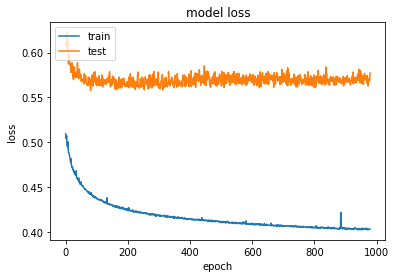

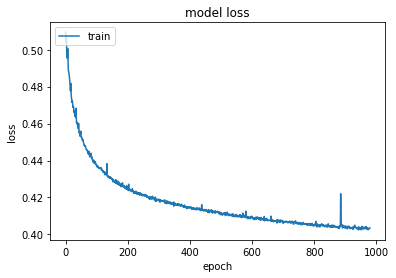

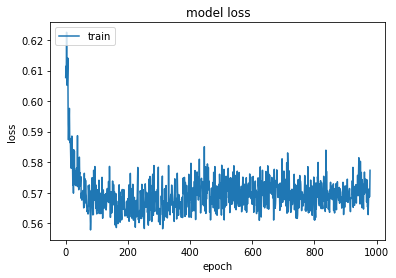

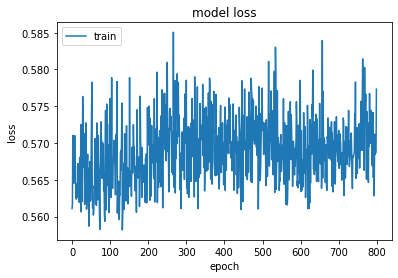

In [56]:
filename = 'best_with_auroral_region2'
model.save(filename)

# model = tensorflow.keras.models.load_model(filename)
model.save(filename)
# model.save_weights('my_model_weights2.h5')


print(history.history.keys())
plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

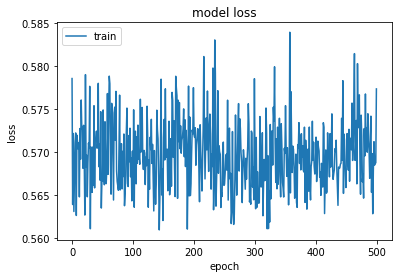

In [57]:
plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][500:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

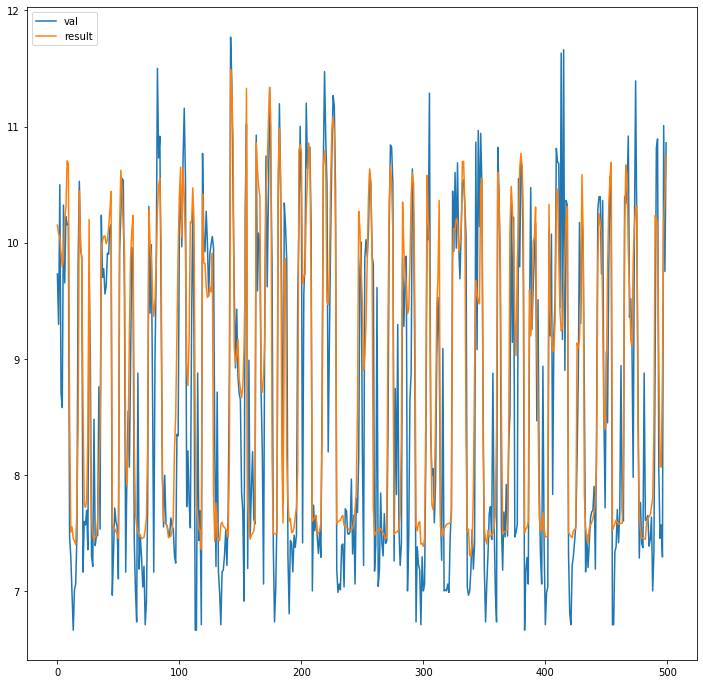

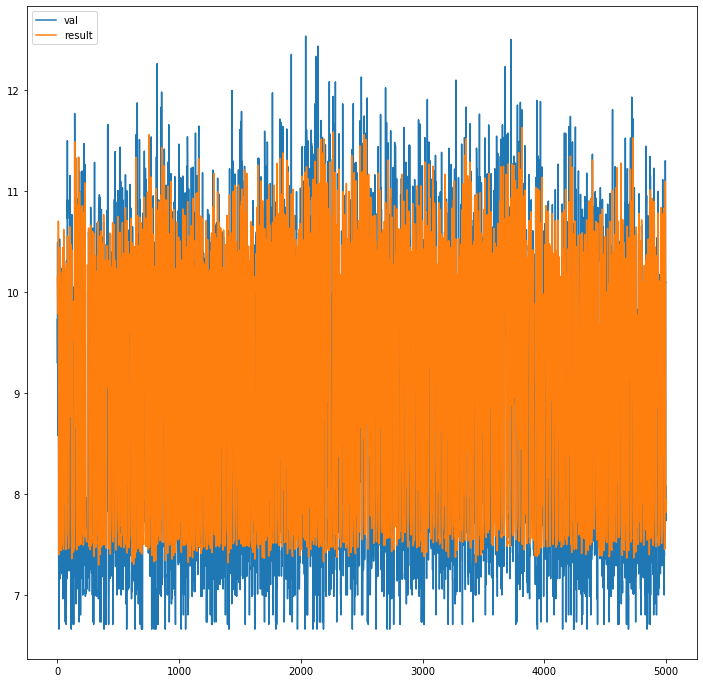

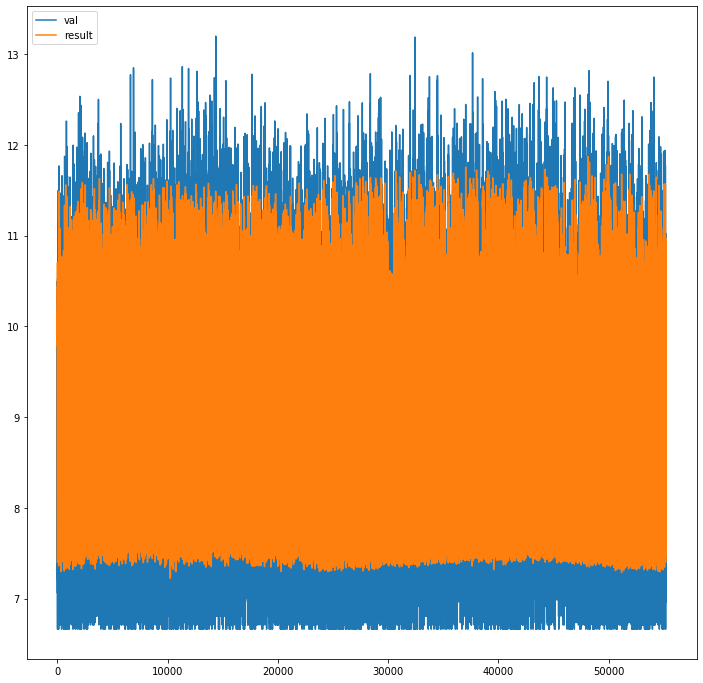

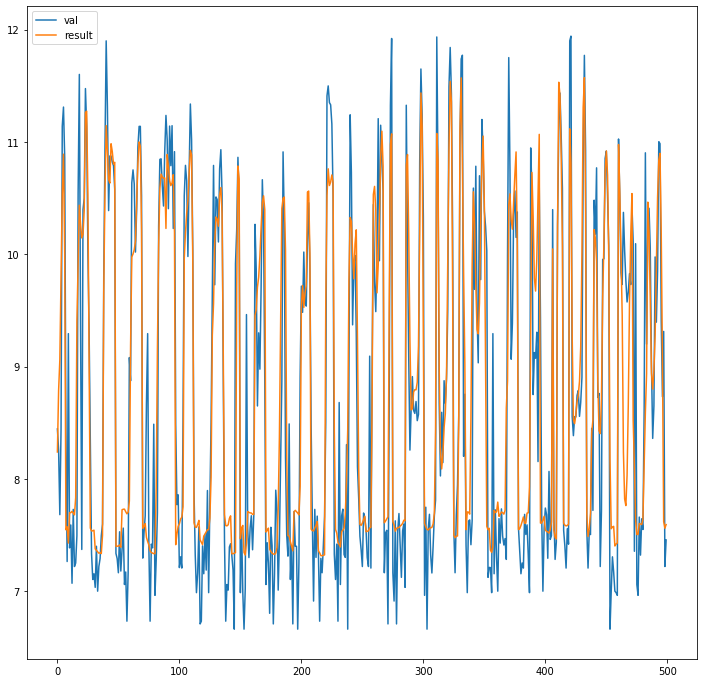

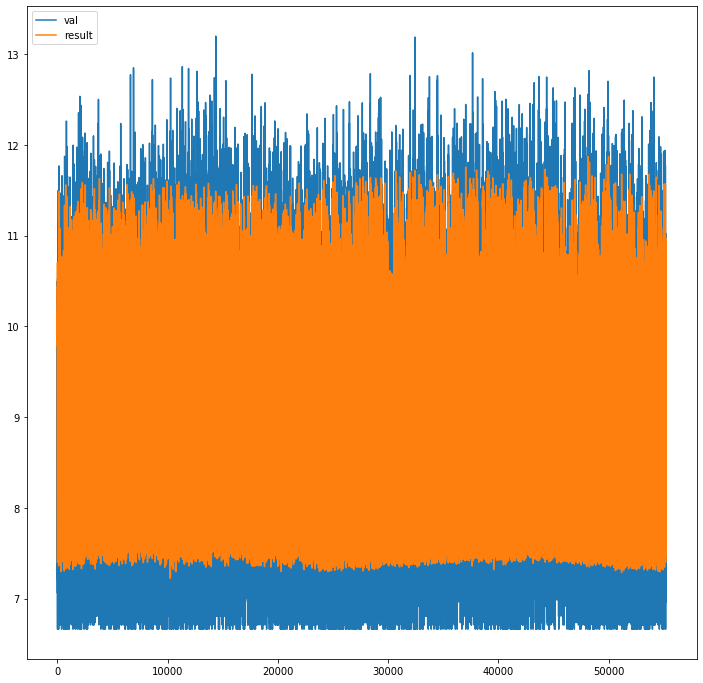

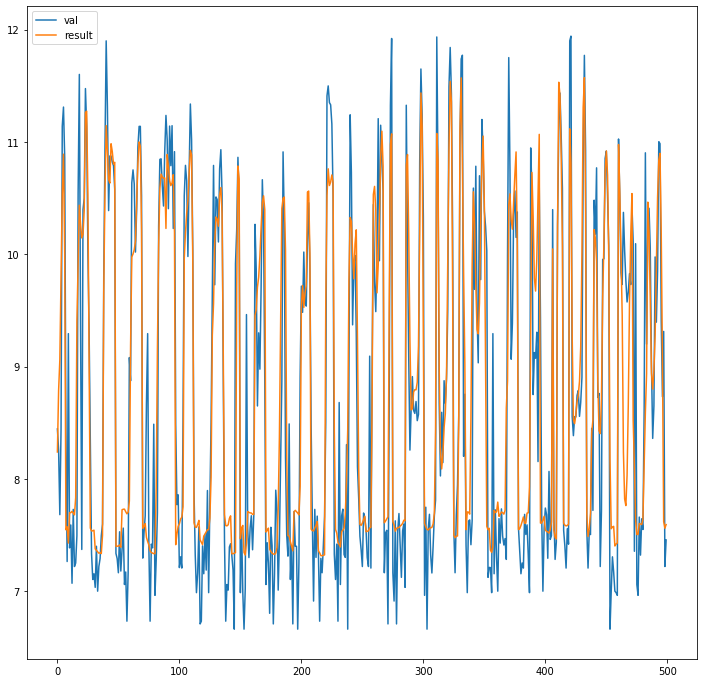

In [58]:
results = model.predict(X_val_scaled)#, y_val_log.values)#, batch_size=128)


plt.figure(figsize=(12,12))
plt.plot(y_val_log.values[:500])
plt.plot(results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure(figsize=(12,12))
plt.plot(y_val_log.values[:5000])
plt.plot(results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure(figsize=(12,12))
plt.plot(y_val_log.values[:])
plt.plot(results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure(figsize=(12,12))
plt.plot(y_val_log.values[-500:])
plt.plot(results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure(figsize=(12,12))
plt.plot(y_val_log.values[:])
plt.plot(results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure(figsize=(12,12))
plt.plot(y_val_log.values[-500:])
plt.plot(results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

# Now with the supervised auroral type values and the predicted (unsupervised) type values as a new column in the input X, predict the scalar energy flux y

# The target Y is now a vector result where the true value only has one of the three as non-zero, the correct answer is specified by the auroral region type, equatorial region, in aurora, and the polar region

# The loss is the MSE of all three, to compare this loss to the previous approach that is signal modal, multiply the loss by the number of modes which is three

In [59]:

# Construct X and y
feature_cols = [c for c in df_train_new.columns if not 'ELE' in c]
X_val = df_val_new[feature_cols].copy(deep=True)
y_val = df_val_new['ELE_TOTAL_ENERGY_FLUX'].copy(deep=True)
X_train = df_train_new[feature_cols].copy(deep=True)
y_train_val = df_train_new['ELE_TOTAL_ENERGY_FLUX'].copy(deep=True)

y_train[y_train == 0] = 0.0001
y_val[y_val == 0] = 0.0001
y_train_log1 = np.log10(y_train.copy(deep=True))
y_val_log1 = np.log10(y_val.copy(deep=True))

y_train_log = np.zeros((y_train_log1.values.shape[0],3))
y_val_log = np.zeros((y_val_log1.values.shape[0],3))

for i in range(0,X_val.values.shape[0]):
    if X_val['aurora_type'].values[i] == 1:
        y_val_log[i,0]=y_val_log1.values[i]
    if X_val['aurora_type'].values[i] == 2:
        y_val_log[i,1]=y_val_log1.values[i]
    if X_val['aurora_type'].values[i] == 3:
        y_val_log[i,2]=y_val_log1.values[i]
for i in range(0,X_train.values.shape[0]):
    if X_train['aurora_type'].values[i] == 1:
        y_train_log[i,0]=y_train_log1.values[i]
    if X_train['aurora_type'].values[i] == 2:
        y_train_log[i,1]=y_train_log1.values[i]
    if X_train['aurora_type'].values[i] == 3:
        y_train_log[i,2]=y_train_log1.values[i]



scaler_X = preprocessing.RobustScaler()
scaler_X = scaler_X.fit(X_train.values)
X_val_scaled = scaler_X.transform(X_val.values)
X_train_scaled = scaler_X.transform(X_train.values)

X = np.array(X_train_scaled, dtype=np.float32)
X_test = np.array(X_val_scaled, dtype=np.float32)



In [60]:
model = Sequential()

model.add(Dense(int(256), activation='relu'))
#model.add(Dropout(.5))
model.add(Dense(64, activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(3))


#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam',  metrics=['mse'])

history = model.fit(X, np.array(y_train_log), validation_data=(X_test, np.array(y_val_log)), batch_size=1024,epochs=1000)

Epoch 1/1000
705/705 [==============================] - 2s 2ms/step - loss: 4.4169 - mse: 4.4169 - val_loss: 0.4636 - val_mse: 0.4636
Epoch 2/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.3218 - mse: 0.3218 - val_loss: 0.3279 - val_mse: 0.3279
Epoch 3/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.2369 - mse: 0.2369 - val_loss: 0.2675 - val_mse: 0.2675
Epoch 4/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1968 - mse: 0.1968 - val_loss: 0.2188 - val_mse: 0.2188
Epoch 5/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1855 - mse: 0.1855 - val_loss: 0.2026 - val_mse: 0.2026
Epoch 6/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1744 - mse: 0.1744 - val_loss: 0.2008 - val_mse: 0.2008
Epoch 7/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.1642 - mse: 0.1642 - val_loss: 0.1945 - val_mse: 0.1945
Epoch 8/1000
705/705 [==============================] - 2s 2ms

Epoch 62/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1135 - mse: 0.1135 - val_loss: 0.1642 - val_mse: 0.1642
Epoch 63/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1144 - mse: 0.1144 - val_loss: 0.1631 - val_mse: 0.1631
Epoch 64/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1129 - mse: 0.1129 - val_loss: 0.1618 - val_mse: 0.1618
Epoch 65/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1119 - mse: 0.1119 - val_loss: 0.1622 - val_mse: 0.1622
Epoch 66/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1116 - mse: 0.1116 - val_loss: 0.1619 - val_mse: 0.1619
Epoch 67/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1127 - mse: 0.1127 - val_loss: 0.1624 - val_mse: 0.1624
Epoch 68/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1127 - mse: 0.1127 - val_loss: 0.1632 - val_mse: 0.1632
Epoch 69/1000
705/705 [==============================] 

705/705 [==============================] - 2s 2ms/step - loss: 0.1085 - mse: 0.1085 - val_loss: 0.1623 - val_mse: 0.1623
Epoch 123/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1046 - mse: 0.1046 - val_loss: 0.1703 - val_mse: 0.1703
Epoch 124/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1043 - mse: 0.1043 - val_loss: 0.1640 - val_mse: 0.1640
Epoch 125/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1038 - mse: 0.1038 - val_loss: 0.1647 - val_mse: 0.1647
Epoch 126/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1040 - mse: 0.1040 - val_loss: 0.1630 - val_mse: 0.1630
Epoch 127/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1057 - mse: 0.1057 - val_loss: 0.1662 - val_mse: 0.1662
Epoch 128/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1046 - mse: 0.1046 - val_loss: 0.1654 - val_mse: 0.1654
Epoch 129/1000
705/705 [==============================] - 2s 2m

705/705 [==============================] - 2s 2ms/step - loss: 0.1013 - mse: 0.1013 - val_loss: 0.1720 - val_mse: 0.1720
Epoch 183/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1011 - mse: 0.1011 - val_loss: 0.1675 - val_mse: 0.1675
Epoch 184/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1035 - mse: 0.1035 - val_loss: 0.1692 - val_mse: 0.1692
Epoch 185/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1003 - mse: 0.1003 - val_loss: 0.1664 - val_mse: 0.1664
Epoch 186/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1002 - mse: 0.1002 - val_loss: 0.1666 - val_mse: 0.1666
Epoch 187/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1000 - mse: 0.1000 - val_loss: 0.1662 - val_mse: 0.1662
Epoch 188/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0999 - mse: 0.0999 - val_loss: 0.1665 - val_mse: 0.1665
Epoch 189/1000
705/705 [==============================] - 2s 2m

705/705 [==============================] - 2s 2ms/step - loss: 0.0977 - mse: 0.0977 - val_loss: 0.1686 - val_mse: 0.1686
Epoch 243/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0978 - mse: 0.0978 - val_loss: 0.1716 - val_mse: 0.1716
Epoch 244/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0980 - mse: 0.0980 - val_loss: 0.1699 - val_mse: 0.1699
Epoch 245/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0984 - mse: 0.0984 - val_loss: 0.1706 - val_mse: 0.1706
Epoch 246/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0980 - mse: 0.0980 - val_loss: 0.1724 - val_mse: 0.1724
Epoch 247/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0972 - mse: 0.0972 - val_loss: 0.1716 - val_mse: 0.1716
Epoch 248/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0976 - mse: 0.0976 - val_loss: 0.1714 - val_mse: 0.1714
Epoch 249/1000
705/705 [==============================] - 2s 2m

705/705 [==============================] - 2s 2ms/step - loss: 0.1376 - mse: 0.1376 - val_loss: 0.1742 - val_mse: 0.1742
Epoch 303/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0973 - mse: 0.0973 - val_loss: 0.1746 - val_mse: 0.1746
Epoch 304/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0959 - mse: 0.0959 - val_loss: 0.1719 - val_mse: 0.1719
Epoch 305/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0957 - mse: 0.0957 - val_loss: 0.1739 - val_mse: 0.1739
Epoch 306/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0956 - mse: 0.0956 - val_loss: 0.1754 - val_mse: 0.1754
Epoch 307/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0955 - mse: 0.0955 - val_loss: 0.1716 - val_mse: 0.1716
Epoch 308/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0954 - mse: 0.0954 - val_loss: 0.1716 - val_mse: 0.1716
Epoch 309/1000
705/705 [==============================] - 2s 2m

705/705 [==============================] - 2s 2ms/step - loss: 0.0941 - mse: 0.0941 - val_loss: 0.1766 - val_mse: 0.1766
Epoch 363/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0941 - mse: 0.0941 - val_loss: 0.1743 - val_mse: 0.1743
Epoch 364/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0942 - mse: 0.0942 - val_loss: 0.1755 - val_mse: 0.1755
Epoch 365/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0942 - mse: 0.0942 - val_loss: 0.1786 - val_mse: 0.1786
Epoch 366/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0972 - mse: 0.0972 - val_loss: 0.1767 - val_mse: 0.1767
Epoch 367/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0945 - mse: 0.0945 - val_loss: 0.1743 - val_mse: 0.1743
Epoch 368/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0940 - mse: 0.0940 - val_loss: 0.1758 - val_mse: 0.1758
Epoch 369/1000
705/705 [==============================] - 2s 2m

705/705 [==============================] - 2s 2ms/step - loss: 0.0928 - mse: 0.0928 - val_loss: 0.1770 - val_mse: 0.1770
Epoch 423/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0932 - mse: 0.0932 - val_loss: 0.1762 - val_mse: 0.1762
Epoch 424/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0930 - mse: 0.0930 - val_loss: 0.1766 - val_mse: 0.1766
Epoch 425/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0930 - mse: 0.0930 - val_loss: 0.1746 - val_mse: 0.1746
Epoch 426/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0930 - mse: 0.0930 - val_loss: 0.1759 - val_mse: 0.1759
Epoch 427/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0928 - mse: 0.0928 - val_loss: 0.1771 - val_mse: 0.1771
Epoch 428/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0931 - mse: 0.0931 - val_loss: 0.1769 - val_mse: 0.1769
Epoch 429/1000
705/705 [==============================] - 2s 2m

705/705 [==============================] - 2s 3ms/step - loss: 0.0921 - mse: 0.0921 - val_loss: 0.1800 - val_mse: 0.1800
Epoch 483/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.0924 - mse: 0.0924 - val_loss: 0.1758 - val_mse: 0.1758
Epoch 484/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.0919 - mse: 0.0919 - val_loss: 0.1811 - val_mse: 0.1811
Epoch 485/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.0919 - mse: 0.0919 - val_loss: 0.1776 - val_mse: 0.1776
Epoch 486/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0919 - mse: 0.0919 - val_loss: 0.1779 - val_mse: 0.1779
Epoch 487/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0919 - mse: 0.0919 - val_loss: 0.1779 - val_mse: 0.1779
Epoch 488/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.1007 - mse: 0.1007 - val_loss: 0.1884 - val_mse: 0.1884
Epoch 489/1000
705/705 [==============================] - 2s 3m

705/705 [==============================] - 2s 2ms/step - loss: 0.0911 - mse: 0.0911 - val_loss: 0.1794 - val_mse: 0.1794
Epoch 543/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0913 - mse: 0.0913 - val_loss: 0.1793 - val_mse: 0.1793
Epoch 544/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0923 - mse: 0.0923 - val_loss: 0.1782 - val_mse: 0.1782
Epoch 545/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0912 - mse: 0.0912 - val_loss: 0.1795 - val_mse: 0.1795
Epoch 546/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0912 - mse: 0.0912 - val_loss: 0.1806 - val_mse: 0.1806
Epoch 547/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0913 - mse: 0.0913 - val_loss: 0.1818 - val_mse: 0.1818
Epoch 548/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0913 - mse: 0.0913 - val_loss: 0.1803 - val_mse: 0.1803
Epoch 549/1000
705/705 [==============================] - 2s 2m

705/705 [==============================] - 2s 2ms/step - loss: 0.0906 - mse: 0.0906 - val_loss: 0.1800 - val_mse: 0.1800
Epoch 603/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0907 - mse: 0.0907 - val_loss: 0.1807 - val_mse: 0.1807
Epoch 604/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0909 - mse: 0.0909 - val_loss: 0.1790 - val_mse: 0.1790
Epoch 605/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.0924 - mse: 0.0924 - val_loss: 0.1797 - val_mse: 0.1797
Epoch 606/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0909 - mse: 0.0909 - val_loss: 0.1805 - val_mse: 0.1805
Epoch 607/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0905 - mse: 0.0905 - val_loss: 0.1805 - val_mse: 0.1805
Epoch 608/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0903 - mse: 0.0903 - val_loss: 0.1820 - val_mse: 0.1820
Epoch 609/1000
705/705 [==============================] - 2s 2m

705/705 [==============================] - 2s 2ms/step - loss: 0.0906 - mse: 0.0906 - val_loss: 0.1809 - val_mse: 0.1809
Epoch 663/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0904 - mse: 0.0904 - val_loss: 0.1798 - val_mse: 0.1798
Epoch 664/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0905 - mse: 0.0905 - val_loss: 0.1819 - val_mse: 0.1819
Epoch 665/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0907 - mse: 0.0907 - val_loss: 0.1812 - val_mse: 0.1812
Epoch 666/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0900 - mse: 0.0900 - val_loss: 0.1821 - val_mse: 0.1821
Epoch 667/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.0899 - mse: 0.0899 - val_loss: 0.1802 - val_mse: 0.1802
Epoch 668/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0901 - mse: 0.0901 - val_loss: 0.1835 - val_mse: 0.1835
Epoch 669/1000
705/705 [==============================] - 2s 2m

705/705 [==============================] - 2s 2ms/step - loss: 0.0897 - mse: 0.0897 - val_loss: 0.1810 - val_mse: 0.1810
Epoch 723/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0894 - mse: 0.0894 - val_loss: 0.1821 - val_mse: 0.1821
Epoch 724/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0896 - mse: 0.0896 - val_loss: 0.1830 - val_mse: 0.1830
Epoch 725/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0895 - mse: 0.0895 - val_loss: 0.1814 - val_mse: 0.1814
Epoch 726/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0894 - mse: 0.0894 - val_loss: 0.1822 - val_mse: 0.1822
Epoch 727/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0894 - mse: 0.0894 - val_loss: 0.1819 - val_mse: 0.1819
Epoch 728/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0895 - mse: 0.0895 - val_loss: 0.1896 - val_mse: 0.1896
Epoch 729/1000
705/705 [==============================] - 2s 2m

705/705 [==============================] - 2s 2ms/step - loss: 0.0889 - mse: 0.0889 - val_loss: 0.1845 - val_mse: 0.1845
Epoch 783/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0888 - mse: 0.0888 - val_loss: 0.1835 - val_mse: 0.1835
Epoch 784/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.0901 - mse: 0.0901 - val_loss: 0.1830 - val_mse: 0.1830
Epoch 785/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0893 - mse: 0.0893 - val_loss: 0.1828 - val_mse: 0.1828
Epoch 786/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.0889 - mse: 0.0889 - val_loss: 0.1840 - val_mse: 0.1840
Epoch 787/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.0890 - mse: 0.0890 - val_loss: 0.1864 - val_mse: 0.1864
Epoch 788/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.0888 - mse: 0.0888 - val_loss: 0.1850 - val_mse: 0.1850
Epoch 789/1000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.0883 - mse: 0.0883 - val_loss: 0.1872 - val_mse: 0.1872
Epoch 843/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0882 - mse: 0.0882 - val_loss: 0.1845 - val_mse: 0.1845
Epoch 844/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.0883 - mse: 0.0883 - val_loss: 0.1852 - val_mse: 0.1852
Epoch 845/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0885 - mse: 0.0885 - val_loss: 0.1846 - val_mse: 0.1846
Epoch 846/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0889 - mse: 0.0889 - val_loss: 0.1839 - val_mse: 0.1839
Epoch 847/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0888 - mse: 0.0888 - val_loss: 0.1847 - val_mse: 0.1847
Epoch 848/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0888 - mse: 0.0888 - val_loss: 0.1858 - val_mse: 0.1858
Epoch 849/1000
705/705 [==============================] - 2s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.0950 - mse: 0.0950 - val_loss: 0.1855 - val_mse: 0.1855
Epoch 903/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0881 - mse: 0.0881 - val_loss: 0.1855 - val_mse: 0.1855
Epoch 904/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0883 - mse: 0.0883 - val_loss: 0.1863 - val_mse: 0.1863
Epoch 905/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.0882 - mse: 0.0882 - val_loss: 0.1849 - val_mse: 0.1849
Epoch 906/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.0882 - mse: 0.0882 - val_loss: 0.1836 - val_mse: 0.1836
Epoch 907/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0881 - mse: 0.0881 - val_loss: 0.1865 - val_mse: 0.1865
Epoch 908/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0881 - mse: 0.0881 - val_loss: 0.1866 - val_mse: 0.1866
Epoch 909/1000
705/705 [==============================] - 2s 2m

705/705 [==============================] - 2s 2ms/step - loss: 0.0876 - mse: 0.0876 - val_loss: 0.1863 - val_mse: 0.1863
Epoch 963/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0875 - mse: 0.0875 - val_loss: 0.1862 - val_mse: 0.1862
Epoch 964/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0873 - mse: 0.0873 - val_loss: 0.1878 - val_mse: 0.1878
Epoch 965/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0874 - mse: 0.0874 - val_loss: 0.1873 - val_mse: 0.1873
Epoch 966/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0875 - mse: 0.0875 - val_loss: 0.1872 - val_mse: 0.1872
Epoch 967/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0975 - mse: 0.0975 - val_loss: 0.1897 - val_mse: 0.1897
Epoch 968/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.0888 - mse: 0.0888 - val_loss: 0.1874 - val_mse: 0.1874
Epoch 969/1000
705/705 [==============================] - 2s 2m

55210
(55210,)


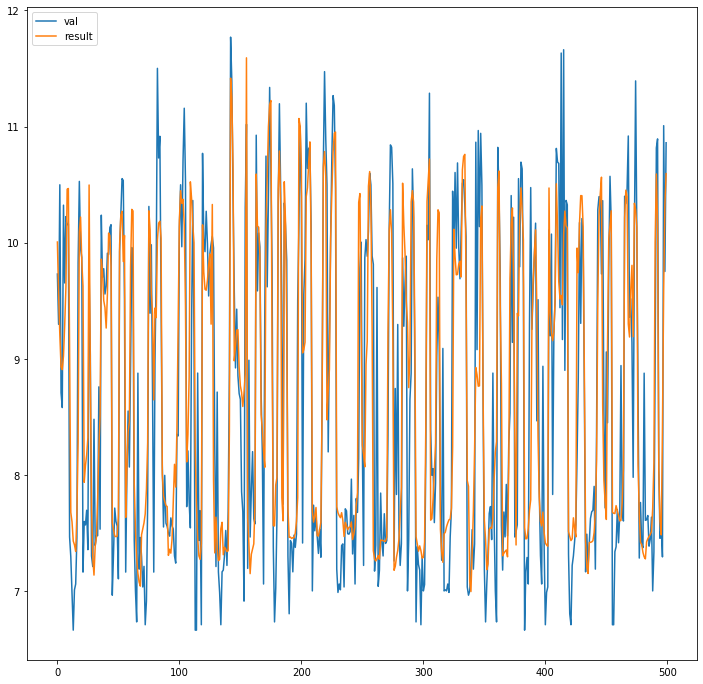

In [61]:
results1 = model.predict(X_val_scaled)#, y_val_log.values)#, batch_size=128)
print(results1.shape[0])
results = np.zeros((results1.shape[0]))
y = np.zeros((results1.shape[0]))
print(y.shape)
for i in range(0,results1.shape[0]):
    results[i]= np.max(results1[i,:])
    y[i] = np.max(y_val_log[i,:])
    
plt.figure(figsize=(12,12))
plt.plot(y[:500])
plt.plot(results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

In [62]:
model = Sequential()

model.add(Dense(int(256), activation='relu'))
model.add(Dropout(.5))
model.add(Dense(64, activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(3))


#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam',  metrics=['mse'])

history = model.fit(X, np.array(y_train_log), validation_data=(X_test, np.array(y_val_log)), batch_size=1024,epochs=1000)

Epoch 1/1000
705/705 [==============================] - 2s 2ms/step - loss: 6.3982 - mse: 6.3982 - val_loss: 0.4116 - val_mse: 0.4116
Epoch 2/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.6545 - mse: 0.6545 - val_loss: 0.3273 - val_mse: 0.3273
Epoch 3/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.4442 - mse: 0.4442 - val_loss: 0.2968 - val_mse: 0.2968
Epoch 4/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.3526 - mse: 0.3526 - val_loss: 0.2785 - val_mse: 0.2785
Epoch 5/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.2989 - mse: 0.2989 - val_loss: 0.2466 - val_mse: 0.2466
Epoch 6/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.2560 - mse: 0.2560 - val_loss: 0.2208 - val_mse: 0.2208
Epoch 7/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.2288 - mse: 0.2288 - val_loss: 0.2024 - val_mse: 0.2024
Epoch 8/1000
705/705 [==============================] - 2s 2ms

Epoch 62/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1463 - mse: 0.1463 - val_loss: 0.1657 - val_mse: 0.1657
Epoch 63/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1474 - mse: 0.1474 - val_loss: 0.1634 - val_mse: 0.1634
Epoch 64/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1472 - mse: 0.1472 - val_loss: 0.1666 - val_mse: 0.1666
Epoch 65/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1456 - mse: 0.1456 - val_loss: 0.1645 - val_mse: 0.1645
Epoch 66/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1407 - mse: 0.1407 - val_loss: 0.1628 - val_mse: 0.1628
Epoch 67/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1458 - mse: 0.1458 - val_loss: 0.1623 - val_mse: 0.1623
Epoch 68/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1459 - mse: 0.1459 - val_loss: 0.1611 - val_mse: 0.1611
Epoch 69/1000
705/705 [==============================] 

705/705 [==============================] - 2s 2ms/step - loss: 0.1352 - mse: 0.1352 - val_loss: 0.1575 - val_mse: 0.1575
Epoch 123/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1321 - mse: 0.1321 - val_loss: 0.1582 - val_mse: 0.1582
Epoch 124/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1373 - mse: 0.1373 - val_loss: 0.1568 - val_mse: 0.1568
Epoch 125/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1335 - mse: 0.1335 - val_loss: 0.1598 - val_mse: 0.1598
Epoch 126/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1367 - mse: 0.1367 - val_loss: 0.1624 - val_mse: 0.1624
Epoch 127/1000
705/705 [==============================] - 2s 3ms/step - loss: 0.1337 - mse: 0.1337 - val_loss: 0.1582 - val_mse: 0.1582
Epoch 128/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1313 - mse: 0.1313 - val_loss: 0.1568 - val_mse: 0.1568
Epoch 129/1000
705/705 [==============================] - 2s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.1288 - mse: 0.1288 - val_loss: 0.1588 - val_mse: 0.1588
Epoch 183/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1280 - mse: 0.1280 - val_loss: 0.1596 - val_mse: 0.1596
Epoch 184/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.1295 - mse: 0.1295 - val_loss: 0.1591 - val_mse: 0.1591
Epoch 185/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.1265 - mse: 0.1265 - val_loss: 0.1578 - val_mse: 0.1578
Epoch 186/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.1266 - mse: 0.1266 - val_loss: 0.1571 - val_mse: 0.1571
Epoch 187/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.1305 - mse: 0.1305 - val_loss: 0.1580 - val_mse: 0.1580
Epoch 188/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1301 - mse: 0.1301 - val_loss: 0.1591 - val_mse: 0.1591
Epoch 189/1000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 2s 2ms/step - loss: 0.1261 - mse: 0.1261 - val_loss: 0.1590 - val_mse: 0.1590
Epoch 243/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1271 - mse: 0.1271 - val_loss: 0.1611 - val_mse: 0.1611
Epoch 244/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1246 - mse: 0.1246 - val_loss: 0.1551 - val_mse: 0.1551
Epoch 245/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1239 - mse: 0.1239 - val_loss: 0.1571 - val_mse: 0.1571
Epoch 246/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1267 - mse: 0.1267 - val_loss: 0.1587 - val_mse: 0.1587
Epoch 247/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1255 - mse: 0.1255 - val_loss: 0.1592 - val_mse: 0.1592
Epoch 248/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.1284 - mse: 0.1284 - val_loss: 0.1569 - val_mse: 0.1569
Epoch 249/1000
705/705 [==============================] - 2s 2m

705/705 [==============================] - 2s 2ms/step - loss: 0.1226 - mse: 0.1226 - val_loss: 0.1551 - val_mse: 0.1551
Epoch 303/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.1253 - mse: 0.1253 - val_loss: 0.1577 - val_mse: 0.1577
Epoch 304/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1250 - mse: 0.1250 - val_loss: 0.1556 - val_mse: 0.1556
Epoch 305/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1258 - mse: 0.1258 - val_loss: 0.1554 - val_mse: 0.1554
Epoch 306/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1225 - mse: 0.1225 - val_loss: 0.1582 - val_mse: 0.1582
Epoch 307/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1238 - mse: 0.1238 - val_loss: 0.1576 - val_mse: 0.1576
Epoch 308/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1237 - mse: 0.1237 - val_loss: 0.1543 - val_mse: 0.1543
Epoch 309/1000
705/705 [==============================] - 2s 2m

705/705 [==============================] - 2s 2ms/step - loss: 0.1217 - mse: 0.1217 - val_loss: 0.1555 - val_mse: 0.1555
Epoch 363/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1218 - mse: 0.1218 - val_loss: 0.1568 - val_mse: 0.1568
Epoch 364/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1229 - mse: 0.1229 - val_loss: 0.1553 - val_mse: 0.1553
Epoch 365/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1252 - mse: 0.1252 - val_loss: 0.1569 - val_mse: 0.1569
Epoch 366/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1254 - mse: 0.1254 - val_loss: 0.1540 - val_mse: 0.1540
Epoch 367/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1221 - mse: 0.1221 - val_loss: 0.1550 - val_mse: 0.1550
Epoch 368/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.1218 - mse: 0.1218 - val_loss: 0.1530 - val_mse: 0.1530
Epoch 369/1000
705/705 [==============================] - 2s 2m

705/705 [==============================] - 2s 2ms/step - loss: 0.1206 - mse: 0.1206 - val_loss: 0.1530 - val_mse: 0.1530
Epoch 423/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.1202 - mse: 0.1202 - val_loss: 0.1539 - val_mse: 0.1539
Epoch 424/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1204 - mse: 0.1204 - val_loss: 0.1541 - val_mse: 0.1541
Epoch 425/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1220 - mse: 0.1220 - val_loss: 0.1556 - val_mse: 0.1556
Epoch 426/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.1227 - mse: 0.1227 - val_loss: 0.1545 - val_mse: 0.1545
Epoch 427/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1207 - mse: 0.1207 - val_loss: 0.1556 - val_mse: 0.1556
Epoch 428/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1218 - mse: 0.1218 - val_loss: 0.1547 - val_mse: 0.1547
Epoch 429/1000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.1205 - mse: 0.1205 - val_loss: 0.1533 - val_mse: 0.1533
Epoch 483/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.1202 - mse: 0.1202 - val_loss: 0.1547 - val_mse: 0.1547
Epoch 484/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1203 - mse: 0.1203 - val_loss: 0.1545 - val_mse: 0.1545
Epoch 485/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1214 - mse: 0.1214 - val_loss: 0.1535 - val_mse: 0.1535
Epoch 486/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1199 - mse: 0.1199 - val_loss: 0.1541 - val_mse: 0.1541
Epoch 487/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.1193 - mse: 0.1193 - val_loss: 0.1543 - val_mse: 0.1543
Epoch 488/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1194 - mse: 0.1194 - val_loss: 0.1553 - val_mse: 0.1553
Epoch 489/1000
705/705 [==============================] - 2s 2m

705/705 [==============================] - 2s 2ms/step - loss: 0.1185 - mse: 0.1185 - val_loss: 0.1548 - val_mse: 0.1548
Epoch 543/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1188 - mse: 0.1188 - val_loss: 0.1552 - val_mse: 0.1552
Epoch 544/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1204 - mse: 0.1204 - val_loss: 0.1543 - val_mse: 0.1543
Epoch 545/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1198 - mse: 0.1198 - val_loss: 0.1542 - val_mse: 0.1542
Epoch 546/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1185 - mse: 0.1185 - val_loss: 0.1535 - val_mse: 0.1535
Epoch 547/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1192 - mse: 0.1192 - val_loss: 0.1532 - val_mse: 0.1532
Epoch 548/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1189 - mse: 0.1189 - val_loss: 0.1526 - val_mse: 0.1526
Epoch 549/1000
705/705 [==============================] - 2s 2m

705/705 [==============================] - 2s 2ms/step - loss: 0.1201 - mse: 0.1201 - val_loss: 0.1532 - val_mse: 0.1532
Epoch 603/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1188 - mse: 0.1188 - val_loss: 0.1537 - val_mse: 0.1537
Epoch 604/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1190 - mse: 0.1190 - val_loss: 0.1576 - val_mse: 0.1576
Epoch 605/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.1195 - mse: 0.1195 - val_loss: 0.1555 - val_mse: 0.1555
Epoch 606/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.1201 - mse: 0.1201 - val_loss: 0.1530 - val_mse: 0.1530
Epoch 607/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.1185 - mse: 0.1185 - val_loss: 0.1555 - val_mse: 0.1555
Epoch 608/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.1197 - mse: 0.1197 - val_loss: 0.1545 - val_mse: 0.1545
Epoch 609/1000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.1197 - mse: 0.1197 - val_loss: 0.1546 - val_mse: 0.1546
Epoch 663/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.1193 - mse: 0.1193 - val_loss: 0.1532 - val_mse: 0.1532
Epoch 664/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.1179 - mse: 0.1179 - val_loss: 0.1533 - val_mse: 0.1533
Epoch 665/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.1181 - mse: 0.1181 - val_loss: 0.1529 - val_mse: 0.1529
Epoch 666/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.1179 - mse: 0.1179 - val_loss: 0.1527 - val_mse: 0.1527
Epoch 667/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.1180 - mse: 0.1180 - val_loss: 0.1546 - val_mse: 0.1546
Epoch 668/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1193 - mse: 0.1193 - val_loss: 0.1540 - val_mse: 0.1540
Epoch 669/1000
705/705 [==============================] - 2s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.1180 - mse: 0.1180 - val_loss: 0.1566 - val_mse: 0.1566
Epoch 723/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.1181 - mse: 0.1181 - val_loss: 0.1541 - val_mse: 0.1541
Epoch 724/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.1186 - mse: 0.1186 - val_loss: 0.1564 - val_mse: 0.1564
Epoch 725/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.1192 - mse: 0.1192 - val_loss: 0.1532 - val_mse: 0.1532
Epoch 726/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1174 - mse: 0.1174 - val_loss: 0.1536 - val_mse: 0.1536
Epoch 727/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1178 - mse: 0.1178 - val_loss: 0.1569 - val_mse: 0.1569
Epoch 728/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.1187 - mse: 0.1187 - val_loss: 0.1543 - val_mse: 0.1543
Epoch 729/1000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 2s 2ms/step - loss: 0.1173 - mse: 0.1173 - val_loss: 0.1538 - val_mse: 0.1538
Epoch 783/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1167 - mse: 0.1167 - val_loss: 0.1527 - val_mse: 0.1527
Epoch 784/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1167 - mse: 0.1167 - val_loss: 0.1542 - val_mse: 0.1542
Epoch 785/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1177 - mse: 0.1177 - val_loss: 0.1544 - val_mse: 0.1544
Epoch 786/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1185 - mse: 0.1185 - val_loss: 0.1522 - val_mse: 0.1522
Epoch 787/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.1178 - mse: 0.1178 - val_loss: 0.1536 - val_mse: 0.1536
Epoch 788/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.1176 - mse: 0.1176 - val_loss: 0.1538 - val_mse: 0.1538
Epoch 789/1000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 2s 2ms/step - loss: 0.1178 - mse: 0.1178 - val_loss: 0.1529 - val_mse: 0.1529
Epoch 843/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1169 - mse: 0.1169 - val_loss: 0.1546 - val_mse: 0.1546
Epoch 844/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.1175 - mse: 0.1175 - val_loss: 0.1549 - val_mse: 0.1549
Epoch 845/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1171 - mse: 0.1171 - val_loss: 0.1538 - val_mse: 0.1538
Epoch 846/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.1196 - mse: 0.1196 - val_loss: 0.1568 - val_mse: 0.1568
Epoch 847/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1182 - mse: 0.1182 - val_loss: 0.1551 - val_mse: 0.1551
Epoch 848/1000
705/705 [==============================] - 1s 2ms/step - loss: 0.1174 - mse: 0.1174 - val_loss: 0.1540 - val_mse: 0.1540
Epoch 849/1000
705/705 [==============================] - 1s 2m

705/705 [==============================] - 1s 2ms/step - loss: 0.1198 - mse: 0.1198 - val_loss: 0.1555 - val_mse: 0.1555
Epoch 903/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1171 - mse: 0.1171 - val_loss: 0.1563 - val_mse: 0.1563
Epoch 904/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1161 - mse: 0.1161 - val_loss: 0.1567 - val_mse: 0.1567
Epoch 905/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1162 - mse: 0.1162 - val_loss: 0.1529 - val_mse: 0.1529
Epoch 906/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1172 - mse: 0.1172 - val_loss: 0.1531 - val_mse: 0.1531
Epoch 907/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1160 - mse: 0.1160 - val_loss: 0.1565 - val_mse: 0.1565
Epoch 908/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1166 - mse: 0.1166 - val_loss: 0.1560 - val_mse: 0.1560
Epoch 909/1000
705/705 [==============================] - 2s 2m

705/705 [==============================] - 2s 2ms/step - loss: 0.1174 - mse: 0.1174 - val_loss: 0.1537 - val_mse: 0.1537
Epoch 963/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1163 - mse: 0.1163 - val_loss: 0.1544 - val_mse: 0.1544
Epoch 964/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1157 - mse: 0.1157 - val_loss: 0.1543 - val_mse: 0.1543
Epoch 965/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1164 - mse: 0.1164 - val_loss: 0.1564 - val_mse: 0.1564
Epoch 966/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1176 - mse: 0.1176 - val_loss: 0.1556 - val_mse: 0.1556
Epoch 967/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1184 - mse: 0.1184 - val_loss: 0.1577 - val_mse: 0.1577
Epoch 968/1000
705/705 [==============================] - 2s 2ms/step - loss: 0.1171 - mse: 0.1171 - val_loss: 0.1555 - val_mse: 0.1555
Epoch 969/1000
705/705 [==============================] - 2s 2m

dict_keys(['loss', 'mse', 'val_loss', 'val_mse'])


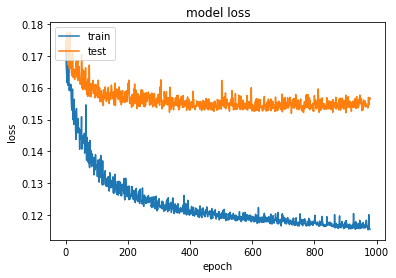

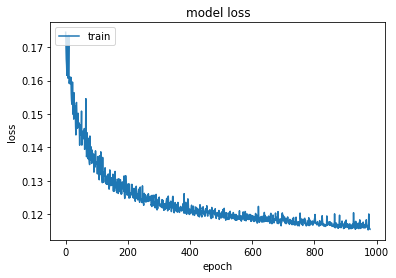

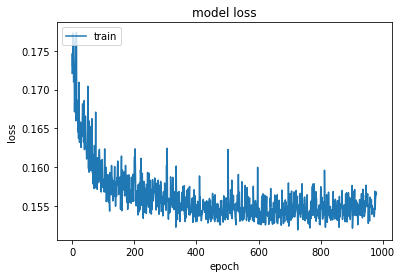

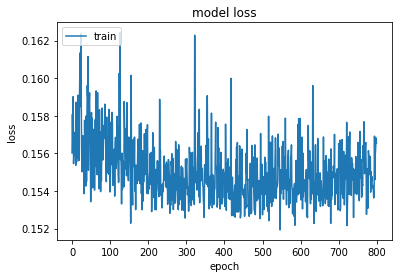

In [63]:
filename = 'best_with_auroral_region4'

# model = tensorflow.keras.models.load_model(filename)
model.save(filename)
# model.save_weights('my_model_weights2.h5')


print(history.history.keys())
plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][20:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['val_loss'][200:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

55210
(55210,)


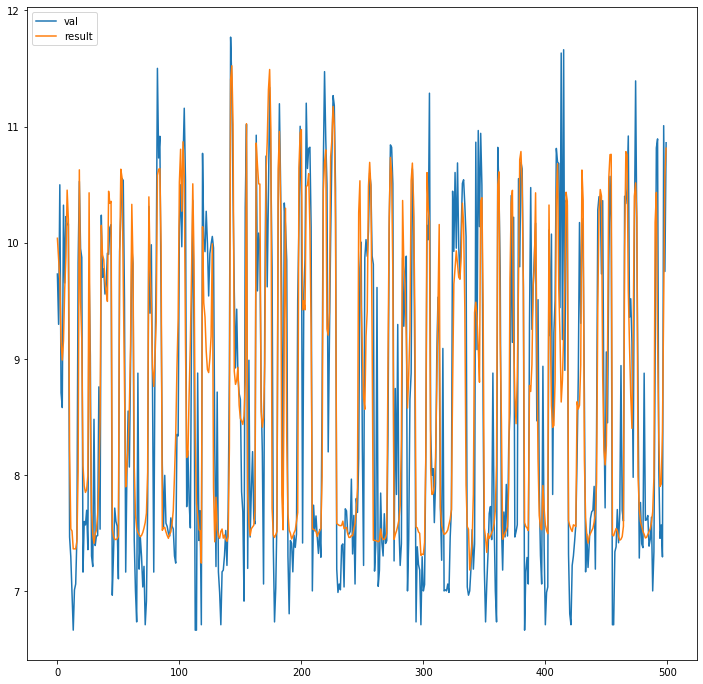

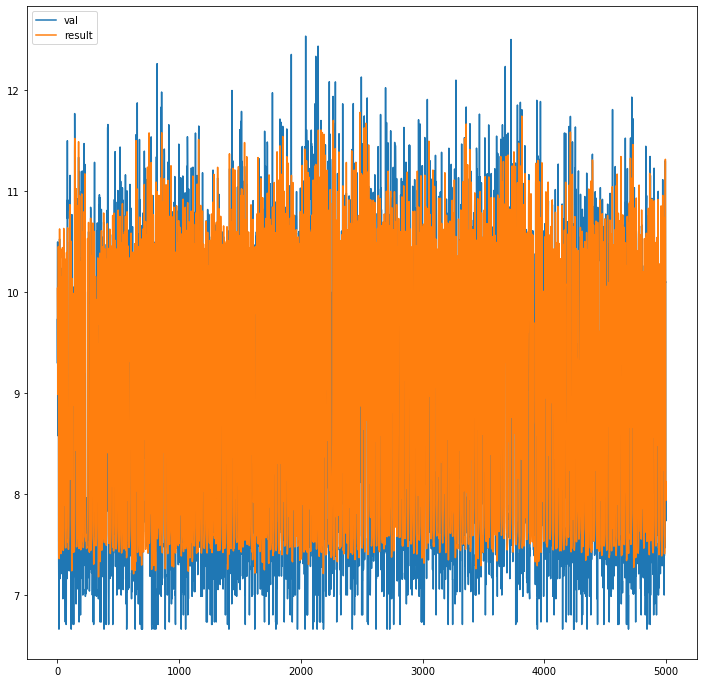

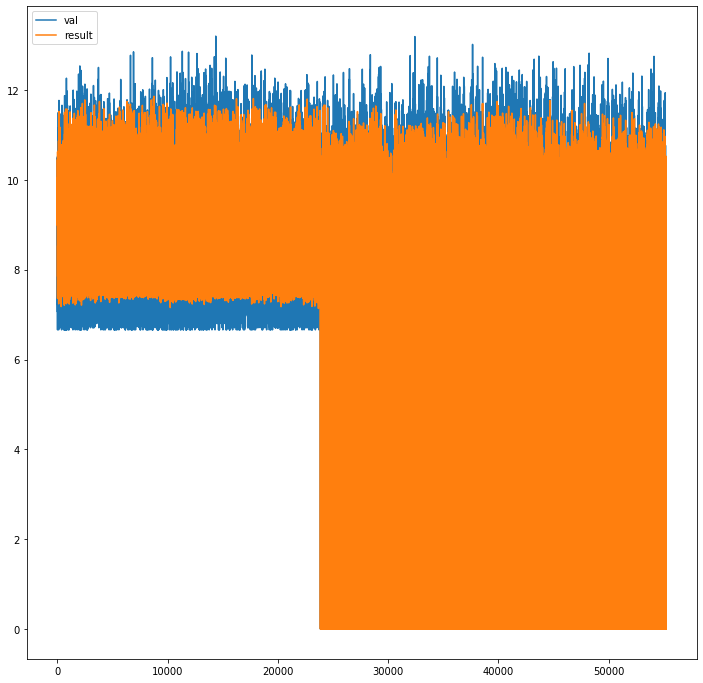

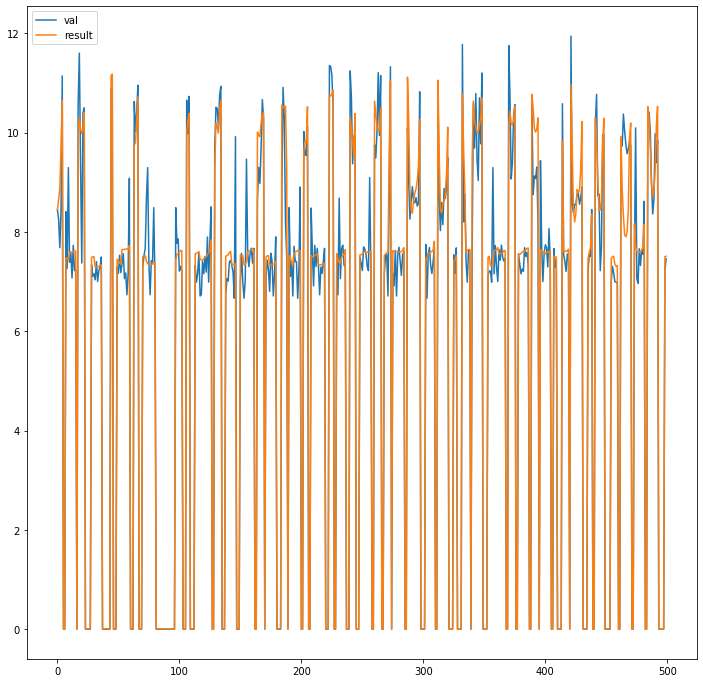

In [64]:
results1 = model.predict(X_val_scaled)#, y_val_log.values)#, batch_size=128)
print(results1.shape[0])
results = np.zeros((results1.shape[0]))
y = np.zeros((results1.shape[0]))
print(y.shape)
for i in range(0,results1.shape[0]):
    results[i]= np.max(results1[i,:])
    y[i] = np.max(y_val_log[i,:])
    
plt.figure(figsize=(12,12))
plt.plot(y[:500])
plt.plot(results[:500])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure(figsize=(12,12))
plt.plot(y[:5000])
plt.plot(results[:5000])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure(figsize=(12,12))
plt.plot(y[:])
plt.plot(results[:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

plt.figure(figsize=(12,12))
plt.plot(y[-500:])
plt.plot(results[-500:])
plt.legend(['val', 'result'], loc='upper left')
plt.show()

# Trying Multi-modal without auroral region type as input for X
(but still using the auroal type to specify y_train and y_val for which of the three modes it is in)

In [67]:
feature_cols = [c for c in X_val.columns if not 'aurora_type' in c]
X_val = X_val[feature_cols].copy(deep=True)
X_train = X_train[feature_cols].copy(deep=True)

scaler_X = preprocessing.RobustScaler()
scaler_X = scaler_X.fit(X_train.values)
X_val_scaled = scaler_X.transform(X_val.values)
X_train_scaled = scaler_X.transform(X_train.values)

X = np.array(X_train_scaled, dtype=np.float32)
X_test = np.array(X_val_scaled, dtype=np.float32)


In [69]:
model = Sequential()

model.add(Dense(int(256), activation='relu'))
#model.add(Dropout(.5))
#model.add(Dense(64, activation='relu'))
#model.add(Dense(16, activation='relu'))
model.add(Dense(3))


#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam',  metrics=['mse'])

history = model.fit(X, np.array(y_train_log), validation_data=(X_test, np.array(y_val_log)), batch_size=1024,epochs=10)

Epoch 1/10
705/705 [==============================] - 2s 2ms/step - loss: 14.2144 - mse: 14.2144 - val_loss: 12.9346 - val_mse: 12.9346
Epoch 2/10
705/705 [==============================] - 1s 2ms/step - loss: 12.4090 - mse: 12.4090 - val_loss: 12.5218 - val_mse: 12.5218
Epoch 3/10
705/705 [==============================] - 1s 2ms/step - loss: 11.8592 - mse: 11.8592 - val_loss: 12.3753 - val_mse: 12.3753
Epoch 4/10
705/705 [==============================] - 1s 2ms/step - loss: 11.5555 - mse: 11.5555 - val_loss: 12.4235 - val_mse: 12.4235
Epoch 5/10
705/705 [==============================] - 1s 2ms/step - loss: 11.4278 - mse: 11.4278 - val_loss: 12.7494 - val_mse: 12.7494
Epoch 6/10
705/705 [==============================] - 1s 2ms/step - loss: 11.1765 - mse: 11.1765 - val_loss: 12.3911 - val_mse: 12.3911
Epoch 7/10
705/705 [==============================] - 1s 2ms/step - loss: 11.0318 - mse: 11.0318 - val_loss: 12.5161 - val_mse: 12.5161
Epoch 8/10
705/705 [============================

In [70]:
model = Sequential()

model.add(Dense(int(256), activation='relu'))
model.add(Dropout(.5))
model.add(Dense(64, activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(3))


#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam',  metrics=['mse'])

history = model.fit(X, np.array(y_train_log), validation_data=(X_test, np.array(y_val_log)), batch_size=1024,epochs=100)

Epoch 1/100
705/705 [==============================] - 2s 2ms/step - loss: 14.9991 - mse: 14.9991 - val_loss: 12.6070 - val_mse: 12.6070
Epoch 2/100
705/705 [==============================] - 2s 2ms/step - loss: 11.9661 - mse: 11.9661 - val_loss: 12.5641 - val_mse: 12.5641
Epoch 3/100
705/705 [==============================] - 2s 2ms/step - loss: 10.9621 - mse: 10.9621 - val_loss: 13.0331 - val_mse: 13.0331
Epoch 4/100
705/705 [==============================] - 1s 2ms/step - loss: 10.3605 - mse: 10.3605 - val_loss: 13.2324 - val_mse: 13.2324
Epoch 5/100
705/705 [==============================] - 2s 2ms/step - loss: 10.0104 - mse: 10.0104 - val_loss: 13.3657 - val_mse: 13.3657
Epoch 6/100
705/705 [==============================] - 2s 2ms/step - loss: 9.7744 - mse: 9.7744 - val_loss: 13.5443 - val_mse: 13.5443
Epoch 7/100
705/705 [==============================] - 2s 2ms/step - loss: 9.5829 - mse: 9.5829 - val_loss: 13.5277 - val_mse: 13.5277
Epoch 8/100
705/705 [========================

705/705 [==============================] - 1s 2ms/step - loss: 7.7695 - mse: 7.7695 - val_loss: 14.3030 - val_mse: 14.3030
Epoch 62/100
705/705 [==============================] - 1s 2ms/step - loss: 7.7544 - mse: 7.7544 - val_loss: 14.4503 - val_mse: 14.4503
Epoch 63/100
705/705 [==============================] - 2s 2ms/step - loss: 7.7365 - mse: 7.7365 - val_loss: 14.4329 - val_mse: 14.4329
Epoch 64/100
705/705 [==============================] - 2s 2ms/step - loss: 7.7169 - mse: 7.7169 - val_loss: 14.5725 - val_mse: 14.5725
Epoch 65/100
705/705 [==============================] - 1s 2ms/step - loss: 7.7223 - mse: 7.7223 - val_loss: 14.3755 - val_mse: 14.3755
Epoch 66/100
705/705 [==============================] - 2s 2ms/step - loss: 7.7097 - mse: 7.7097 - val_loss: 14.2727 - val_mse: 14.2727
Epoch 67/100
705/705 [==============================] - 1s 2ms/step - loss: 7.6957 - mse: 7.6957 - val_loss: 14.7124 - val_mse: 14.7124
Epoch 68/100
705/705 [==============================] - 2s 2m

dict_keys(['loss', 'mse', 'val_loss', 'val_mse'])


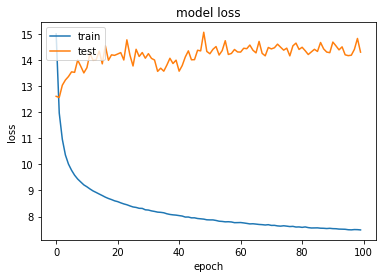

In [71]:
# filename = 'best_with_auroral_region3'

# # model = tensorflow.keras.models.load_model(filename)
# model.save(filename)
# # model.save_weights('my_model_weights2.h5')


print(history.history.keys())
plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][:])
plt.plot(history.history['val_loss'][:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()



55210
(55210,)


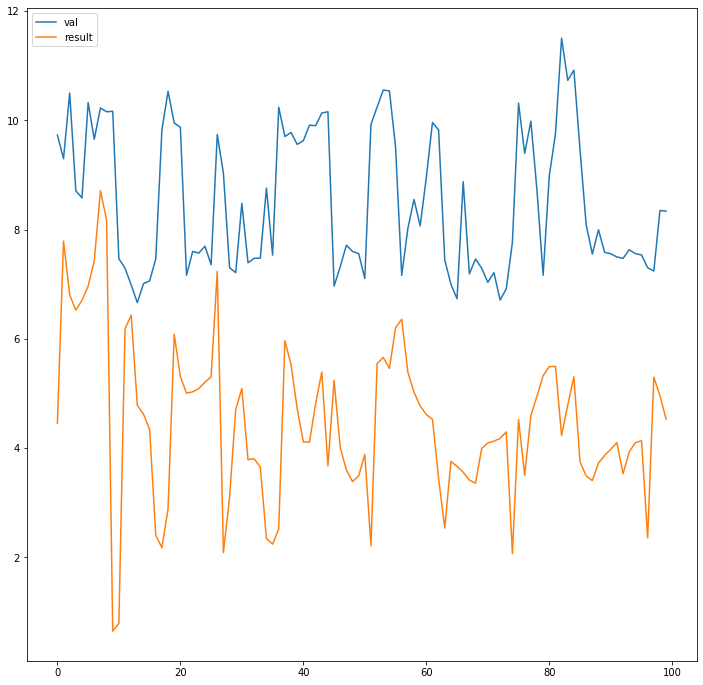

In [72]:
results1 = model.predict(X_val_scaled)#, y_val_log.values)#, batch_size=128)
print(results1.shape[0])
results = np.zeros((results1.shape[0]))
y = np.zeros((results1.shape[0]))
print(y.shape)
for i in range(0,results1.shape[0]):
    results[i]= np.max(results1[i,:])
    y[i] = np.max(y_val_log[i,:])
    
plt.figure(figsize=(12,12))
plt.plot(y[:100])
plt.plot(results[:100])
plt.legend(['val', 'result'], loc='upper left')
plt.show()
